# Compare Exp on ref value

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.ticker import MultipleLocator
from matplotlib.lines import Line2D

plt.rcParams.update({
    "font.size": 10,
    "axes.grid": False,
    "axes.edgecolor": "black",
    "xtick.color": "black",
    "ytick.color": "black",
    "grid.color": "black",   # if any grid accidentally appears
})


def plot_exp_compare(results_dir, exp_dir, case_names, save_fig):
    # Define the variables to plot
    variables = [ 
        'X_N2', 'X_NH3', 'X_H2',
        'X_H2O', 'X_O2', 'X_NO',
    ]
    
    # Create a 2x3 grid for subplots (6 subplots)
    fig, axes = plt.subplots(2, 3, figsize=(10, 6))
    axes = axes.flatten()

    # Define markers for each case to ensure consistency
    markers = ['o', 's', '^', 'v', '<', '>', 'p', '*', 'H', '+', 'x']

    colors = [
        'b',    # blue
        'g',    # green
        'r',    # red
        'c',    # cyan
        'm',    # magenta
        'y',    # yellow
        'k',    # black
        'orange', 
        'purple',
        'brown',
        'pink'
    ]

    # Loop over each case
    for idx, case_name in enumerate(case_names):
        # Read experimental and simulation data
        exp_file = os.path.join(exp_dir, f"{case_name}.csv")
        sim_file = os.path.join(results_dir, f"{case_name}.csv")
        
        # Check if both files exist
        if os.path.exists(exp_file) and os.path.exists(sim_file):
            exp_data = pd.read_csv(exp_file)
            sim_data = pd.read_csv(sim_file)
            
            # Get the marker for this case
            marker = markers[idx % len(markers)]
            
            # Loop over the variables and create the plots
            for var_idx, var in enumerate(variables):
                ax = axes[var_idx]
                
                # If the variable is 'X_NO', multiply by 1e6 for simulation data
                if var == 'X_NO':
                    sim_data[var] *= 1e6

                # Plot simulation data (hollow markers for the simulation with line)
                # ax.plot(sim_data['T'], sim_data[var], linestyle='--', 
                        # color=colors[idx % len(colors)], label=f'{case_name} (Sim)')
                ax.plot(sim_data['T'], sim_data[var], linestyle='--', 
                        color=colors[idx % len(colors)])                
                # Plot experimental data (hollow markers, remove edgecolor for markers that don't support it)
                if marker not in ['+', 'x']:  # These markers don't support edgecolor
                    ax.scatter(exp_data['T'], exp_data[var], label=f'{case_name}', 
                            edgecolor=colors[idx % len(colors)], facecolors='none', marker=marker)
                else:
                    ax.scatter(exp_data['T'], exp_data[var], label=f'{case_name}', 
                            facecolors='none', marker=marker)
                
                ax.set_xlabel('T (K)')
                if var.startswith('X_'):
                    sub = var.split('_', 1)[1]
                    ax.set_ylabel(f"$X_{{{sub}}}$")
                elif var == 'Qdot':
                    ax.set_ylabel('HRR (J/kg/s)')
                else:
                    ax.set_ylabel(f"${var}$")
        
        else:
            print(f"Warning: Missing data for case {case_name}, skipping...")

    # Create a common legend on the right side of the figure
    # handles, labels = ax.get_legend_handles_labels()
    # fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), fontsize=18)

    # After plotting all cases, add a legend inside the subplot at [0,2]
    ax2 = axes[2]  # top row, third column
    handles2, labels2 = ax2.get_legend_handles_labels()
    ax2.legend(handles2, labels2,
               loc='upper right',
               fontsize=8,
               frameon=False)

    # Adjust layout, save, and show
    plt.tight_layout()
    plt.savefig(save_fig, bbox_inches='tight', pad_inches=0.02, dpi=300)
    plt.show()

# Compare Exp on ref value

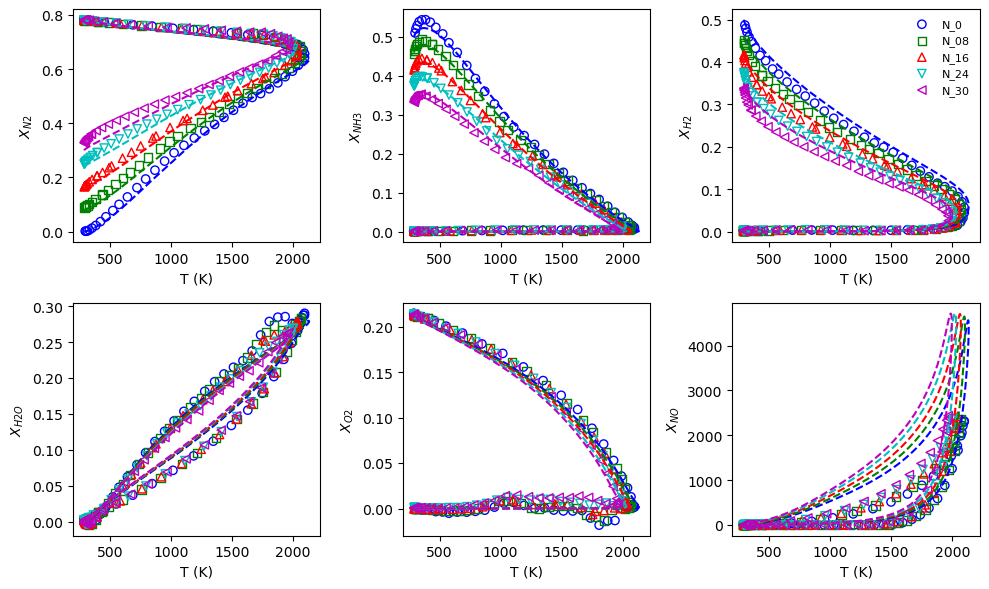

In [3]:
mechanims_list = [
    'Han_35s177r',
    'KAUST_32s243r',
    'Marshall_33s221r',
    'Mei_39s256r',
    'NH3_otomo',
]

case_names = [
    'N_0',  'N_08',  'N_16', 'N_24', 'N_30'
]
exp_dir = "EXP_data/NH3_NP_CF_EXP"
results_dir = "SIM_results/NH3_NP_CF_reduce/Mei_39s256r"
save_fig_dir = 'SIM_results/NH3_NP_CF_ref/Nseries_plots.pdf'
plot_exp_compare(results_dir, exp_dir, case_names, save_fig_dir)

# # Define the case names
# case_names = [
# 'AH82', 'AH64', 'AH46',
#      'AH64_K80', 'AH64_K120', 'AH64_K140'
# ]
# exp_dir = "EXP_data/NH3_NP_CF_EXP"
# results_dir = "SIM_results/NH3_NP_CF_ref"
# save_fig_dir = 'SIM_results/NH3_NP_CF_ref/AHseries_plots.pdf'
# plot_exp_compare(results_dir, exp_dir, case_names, save_fig_dir)

# Plot the comparison of the Exp on space!

In [4]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Compact 1‑D counter‑flow comparison plotter.

Call `plot_counterflow()` with whatever cases / shifts / species you need and
a PDF will be written to `fig_dir`.
"""

import os
from pathlib import Path
from typing import Sequence, List, Optional

import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D


# ──────────────────────────────────────────────────────────────────────────
# main plotting routine
# ──────────────────────────────────────────────────────────────────────────
def plot_counterflow(
    exp_case_dir: str,
    sim_case_dir: str,
    fig_dir: str,
    target_cases: Sequence[str],
    exp_shift: Sequence[float],
    sim_shift: Sequence[float],
    species: Sequence[str] = (
        "T", "X_NH3", "X_O2", "X_H2", "X_H2O", "X_NO", "X_N2"
    ),
    x_ranges: Optional[Sequence[Sequence[float]]] = None,
    pdf_name: str = "1D_compact_comparison.pdf",
    exp_color: str = "black",
    sim_color: str = "red",
) -> None:
    """
    Parameters
    ----------
    exp_case_dir : str
        Folder that contains experimental CSVs:  <exp_case_dir>/<case>.csv
    sim_case_dir : str
        Folder that contains simulation   CSVs:  <sim_case_dir>/<case>.csv
    fig_dir : str
        Directory where the PDF will be saved (will be created if missing)
    target_cases : list[str]
        Case names to plot (order = column order)
    exp_shift, sim_shift : list[float]
        Horizontal shift (mm) applied to the experimental and simulation grids
        for each case (must have same length as `target_cases`).
        `sim_shift` is applied AFTER mirroring.
    species : list[str], default see above
        Species (or T) to plot in rows (order = row order).
    x_ranges : list[[xmin, xmax]], default None
        x‑axis range for each column. If None, range is auto‑scaled.
    pdf_name : str
        Output PDF file name.
    """

    if len(exp_shift) != len(target_cases) or len(sim_shift) != len(target_cases):
        raise ValueError("exp_shift and sim_shift must match length of target_cases")

    if x_ranges is None:
        x_ranges = [[None, None]] * len(target_cases)

 
    ymins = {sp: float('inf') for sp in species}
    ymaxs = {sp: -float('inf') for sp in species}
    for case in target_cases:
        df_sim = pd.read_csv(Path(sim_case_dir) / f"{case}.csv")
        df_exp = pd.read_csv(Path(exp_case_dir) / f"{case}.csv")
        for sp in species:
            # simulation
            if sp in df_sim:
                arr = df_sim[sp].to_numpy()
                ymins[sp] = min(ymins[sp], arr.min())
                ymaxs[sp] = max(ymaxs[sp], arr.max()) * 1.01
            # experiment
            if sp in df_exp:
                arr = df_exp[sp].to_numpy()
                if sp == "X_NO":
                    arr = arr / 1e6
                ymins[sp] = min(ymins[sp], arr.min())
                ymaxs[sp] = max(ymaxs[sp], arr.max()) * 1.01
 

    plt.rcParams.update({
        "font.size": 8,
        "axes.grid": False,
        "axes.edgecolor": "black",
        "xtick.color": "black",
        "ytick.color": "black",
        "grid.color": "black",   # if any grid accidentally appears
    })

    fig, axs = plt.subplots(
        len(species), len(target_cases), figsize=(8.73, 1.1 * len(species))
    )

    for ax in axs.ravel():
        ax.grid(False)
        for spine in ax.spines.values():
            spine.set_color("black")


    for col_idx, case in enumerate(target_cases):
        sim_path = Path(sim_case_dir) / f"{case}.csv"
        exp_path = Path(exp_case_dir) / f"{case}.csv"

        if not sim_path.is_file():
            raise FileNotFoundError(sim_path)
        if not exp_path.is_file():
            raise FileNotFoundError(exp_path)

        df_sim = pd.read_csv(sim_path)
        df_exp = pd.read_csv(exp_path)

        x_sim = df_sim["grid"].to_numpy() * 1000  # mm
        x_exp = df_exp["x"].to_numpy()            # mm (already in mm)

        # apply shifts
        x_sim_shifted = x_sim + sim_shift[col_idx]      # mirror + shift
        x_exp_shifted = x_exp + exp_shift[col_idx]

        for row_idx, sp in enumerate(species):
            ax = axs[row_idx, col_idx]

            # ── CVODE / simulation line ───────────────────────────────
            ax.plot(
                x_sim_shifted,
                df_sim[sp].to_numpy(),
                linestyle="--",
                linewidth=1,
                color=sim_color,
                label="CVODE" if (row_idx == 0 and col_idx == 0) else "",
            )

            # ── Experimental scatter ─────────────────────────────────
            if sp in df_exp.columns:
                y_exp = df_exp[sp].to_numpy()
                if sp == "X_NO":            # convert ppm to mole fraction
                    y_exp = y_exp / 1e6
                ax.scatter(
                    x_exp_shifted,
                    y_exp,
                    s=8,
                    alpha=1,
                    linewidths=0.5,
                    marker="o",
                    facecolors="none",
                    edgecolors=exp_color,
                    label="Exp" if (row_idx == 0 and col_idx == 0) else "",
                )

            # cosmetics -------------------------------------------------
            xmin, xmax = x_ranges[col_idx]
            if row_idx == 0:
                ax.set_title(target_cases[col_idx], fontsize=8)
                
            xmin, xmax = x_ranges[col_idx]
            if xmin is not None:
                ax.set_xlim(xmin, xmax)
            ax.set_ylim(ymins[sp], ymaxs[sp])

            if col_idx == 0:
                if sp == 'T':
                    ax.set_ylabel('T (K)', fontsize=8)
                else:
                    ax.set_ylabel(sp, fontsize=8)
            else:
                ax.set_yticklabels([])
            if row_idx == len(species) - 1:
                ax.set_xlabel("x (mm)", fontsize=8)
            else:
                ax.set_xticklabels([])

    # ── global legend ─────────────────────────────────────────────────
    handles = [
        Line2D([0], [0], linestyle="-", color=sim_color, label="CVODE"),
        Line2D(
            [0],
            [0],
            marker="o",
            linestyle="None",
            markerfacecolor="none",
            markeredgecolor=exp_color,
            label="Exp",
        ),
    ]

    plt.subplots_adjust(top=0.93, right=0.85, wspace=0.1, hspace=0.1)
    fig.legend(
        handles=handles,
        loc="upper center",
        ncol=2,
        fontsize=8,
        frameon=False,
        bbox_to_anchor=(0.5, 1),
    )

    # ── save figure ──────────────────────────────────────────────────
    Path(fig_dir).mkdir(parents=True, exist_ok=True)
    out_file = Path(fig_dir) / pdf_name
    fig.savefig(out_file, dpi=300, bbox_inches="tight")
    print(f"figure saved → {out_file}")


figure saved → figs/NH3_NP_CF/N_series_1D_compact_comparison_Sim.pdf
figure saved → figs/NH3_NP_CF/AH_1D_compact_comparison_Sim.pdf


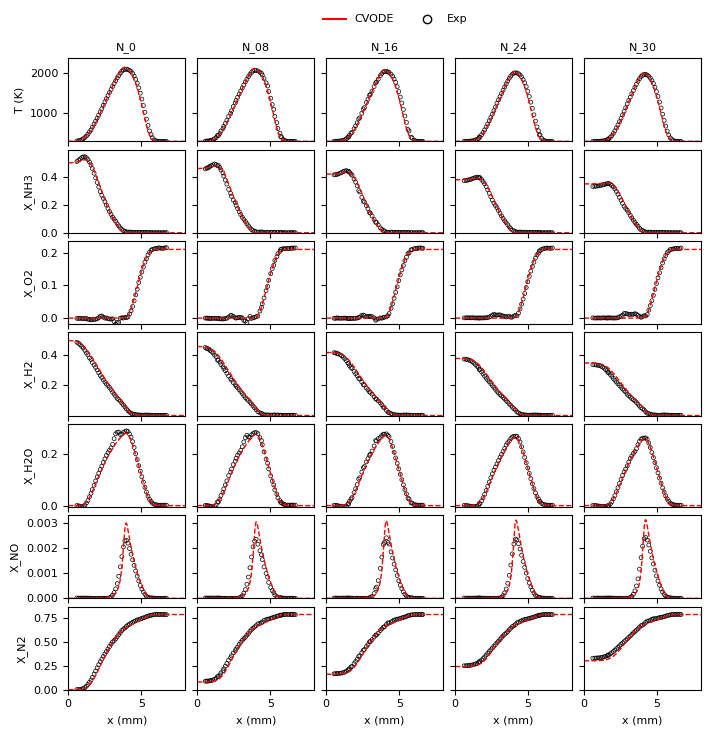

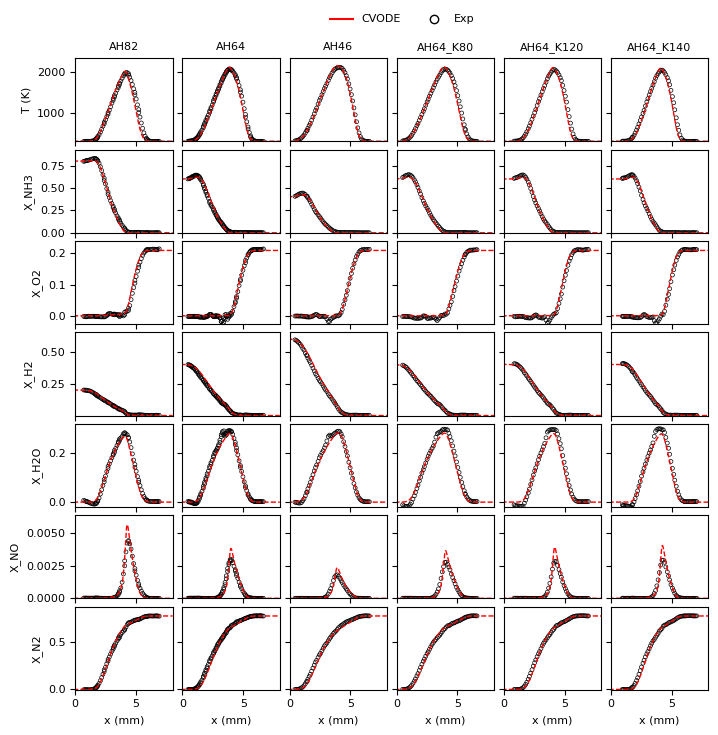

In [5]:
mechanims_list = [
    'Han_35s177r',
    'KAUST_32s243r',
    'Marshall_33s221r',
    'Mei_39s256r',
    'NH3_otomo',
]


plot_counterflow(
    exp_case_dir="EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce/NH3_otomo",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    species=["T", "X_NH3", "X_O2", "X_H2", "X_H2O", "X_NO", "X_N2"],
    x_ranges=[[0, 8]] * 5,
    pdf_name="N_series_1D_compact_comparison_Sim.pdf",
)

plot_counterflow(
    exp_case_dir="EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce/NH3_otomo",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    species=["T", "X_NH3", "X_O2", "X_H2", "X_H2O", "X_NO", "X_N2"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_1D_compact_comparison_Sim.pdf",
)


# Try to modify the strain rate

figure saved → figs/NH3_NP_CF/N_series_1D_compact_comparison_Sim_low_SR.pdf
figure saved → figs/NH3_NP_CF/AH_1D_compact_comparison_Sim.pdf


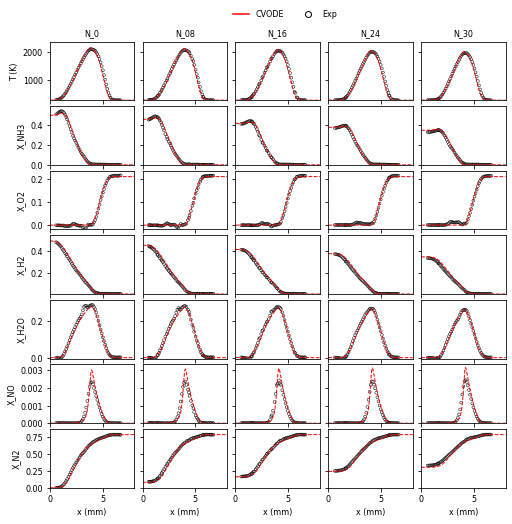

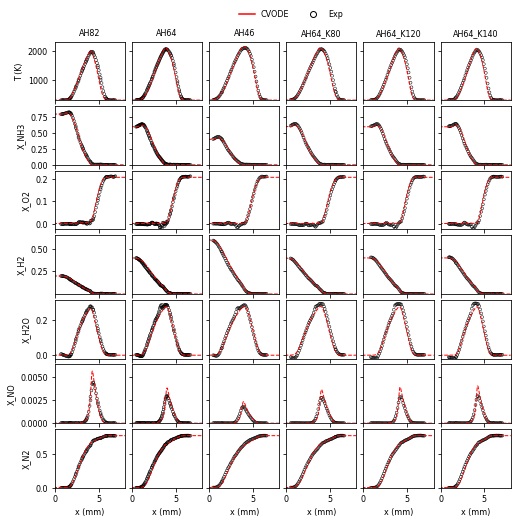

In [5]:
plot_counterflow(
    exp_case_dir="EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_0_8SR",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    species=["T", "X_NH3", "X_O2", "X_H2", "X_H2O", "X_NO", "X_N2"],
    x_ranges=[[0, 8]] * 5,
    pdf_name="N_series_1D_compact_comparison_Sim_low_SR.pdf",
)

plot_counterflow(
    exp_case_dir="EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_0_8SR",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    species=["T", "X_NH3", "X_O2", "X_H2", "X_H2O", "X_NO", "X_N2"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_1D_compact_comparison_Sim.pdf",
)


# Plot the Exp reconstructed results using different mechanism!


[N_0] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/N_0/comparison_2x4_N_0.png
[N_08] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/N_08/comparison_2x4_N_08.png
[N_16] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/N_16/comparison_2x4_N_16.png
[N_24] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/N_24/comparison_2x4_N_24.png
[N_30] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/N_30/comparison_2x4_N_30.png
[AH82] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH82/comparison_2x4_AH82.png
[AH64] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH64/comparison_2x4_AH64.png
[AH46] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH46/comparison_2x4_AH46.png
[AH64_K80] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH64_K80/comparison_2x4_AH64_K80.png
[AH64_K120] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH64_K120/comparison_2x4_AH64_K120.png
[AH64_K140] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH64_K140/comparison_2x4_AH64_K140.png


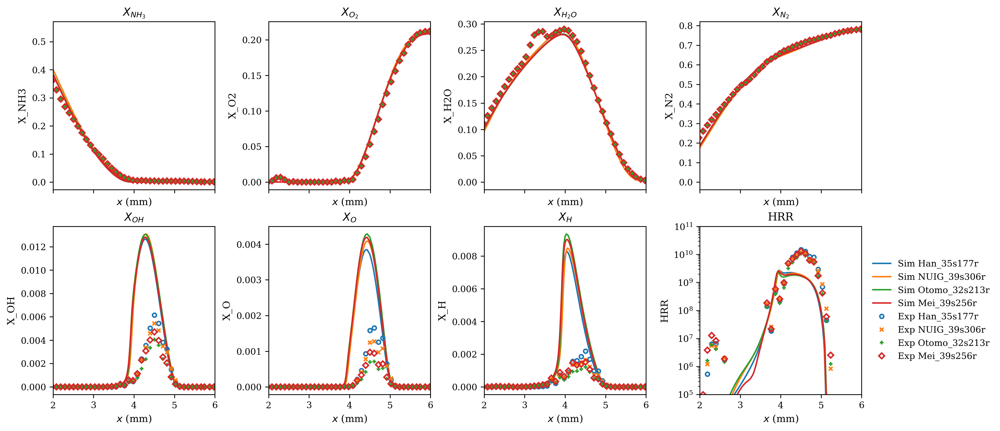

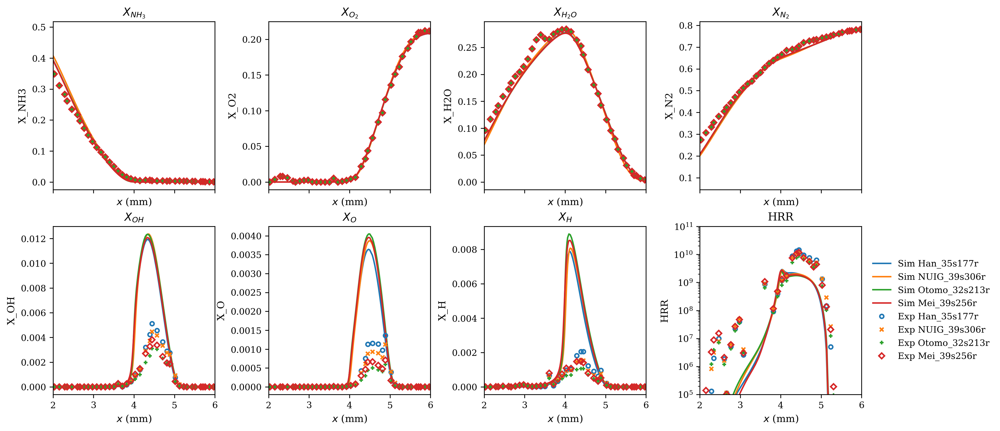

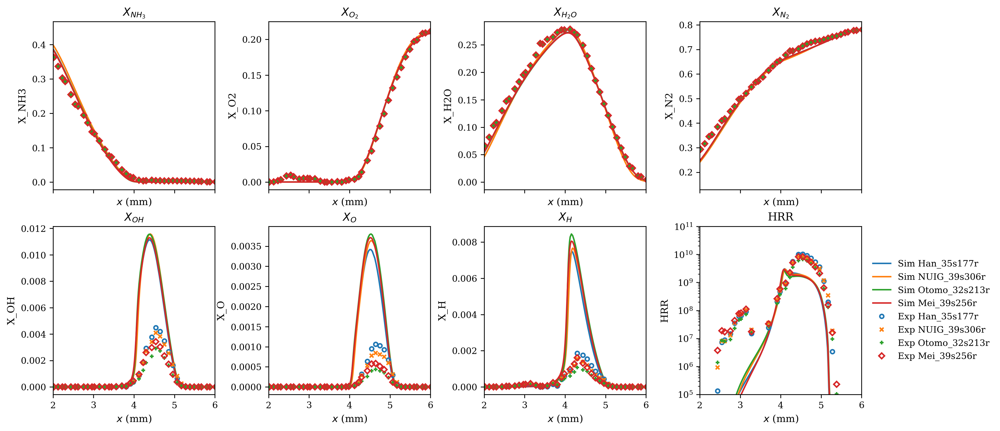

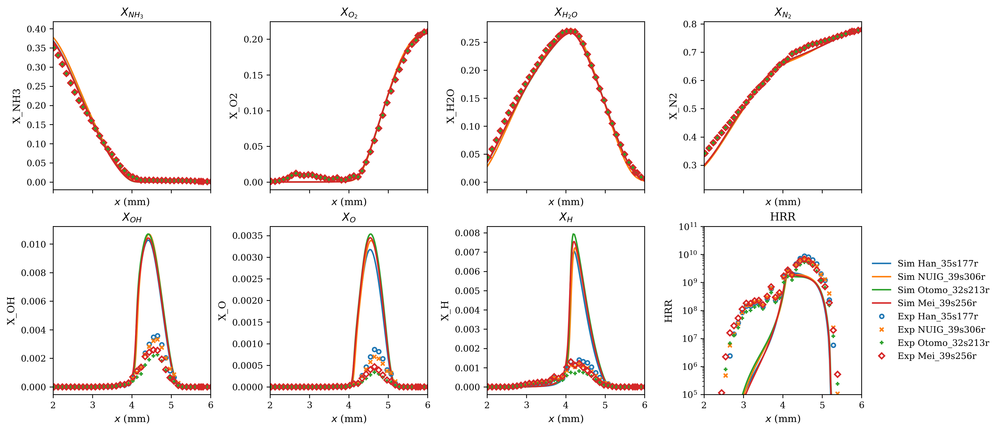

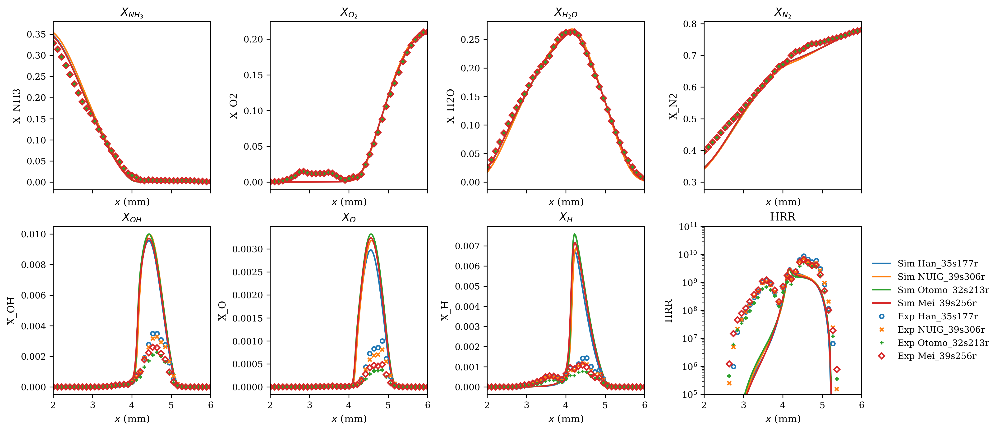

...

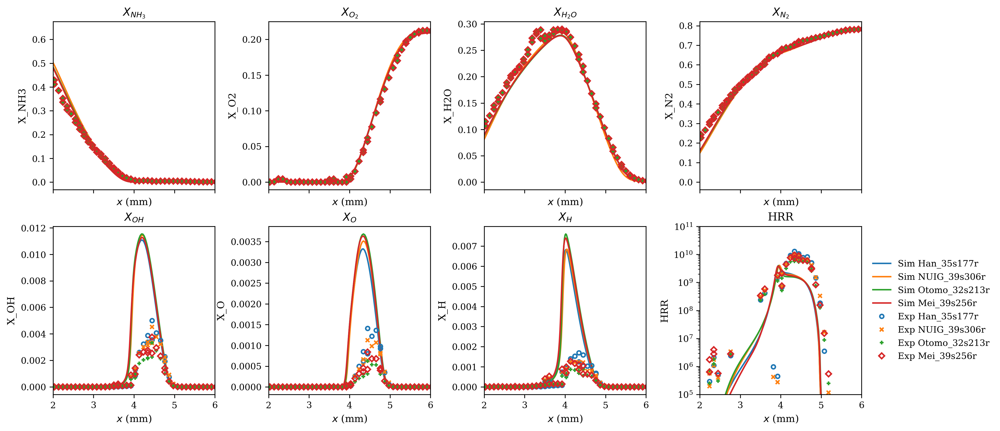

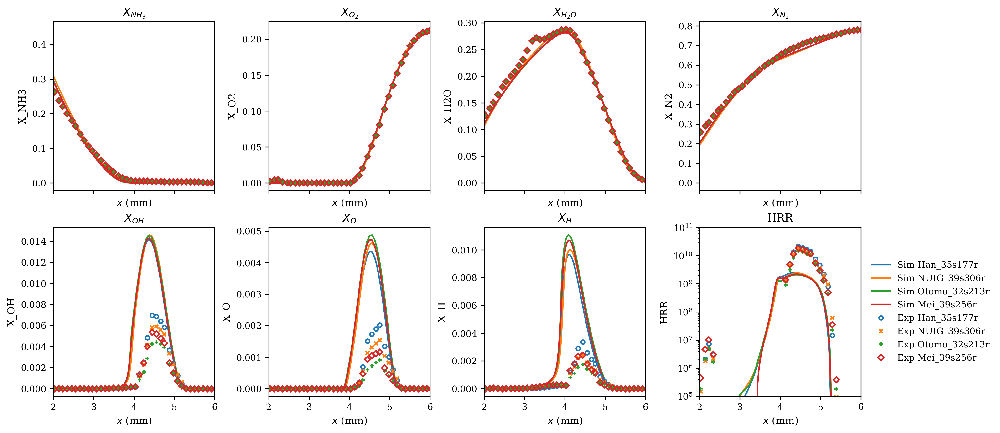

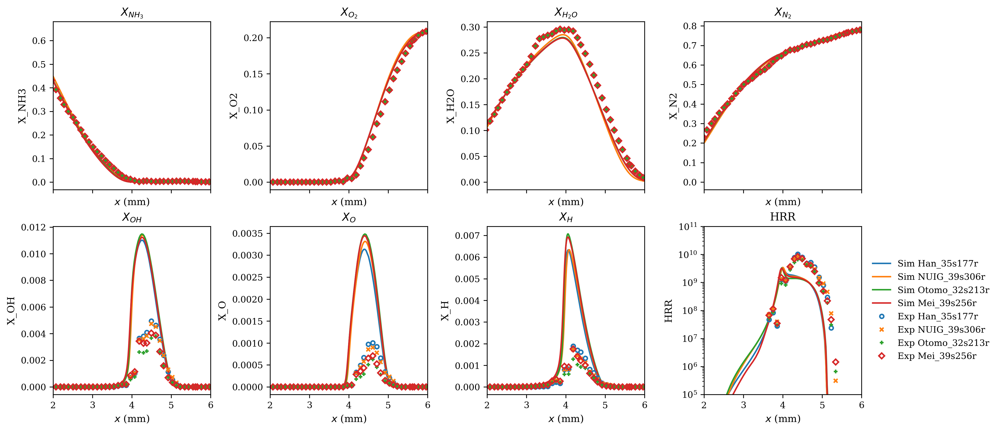

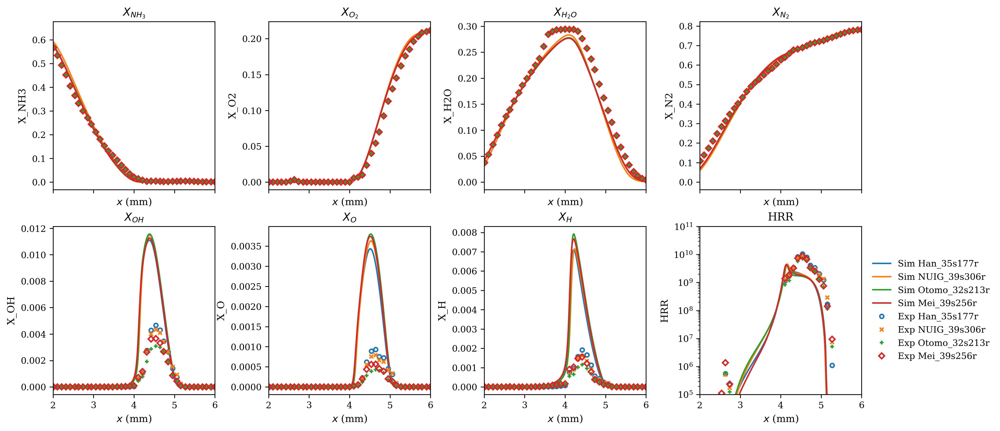

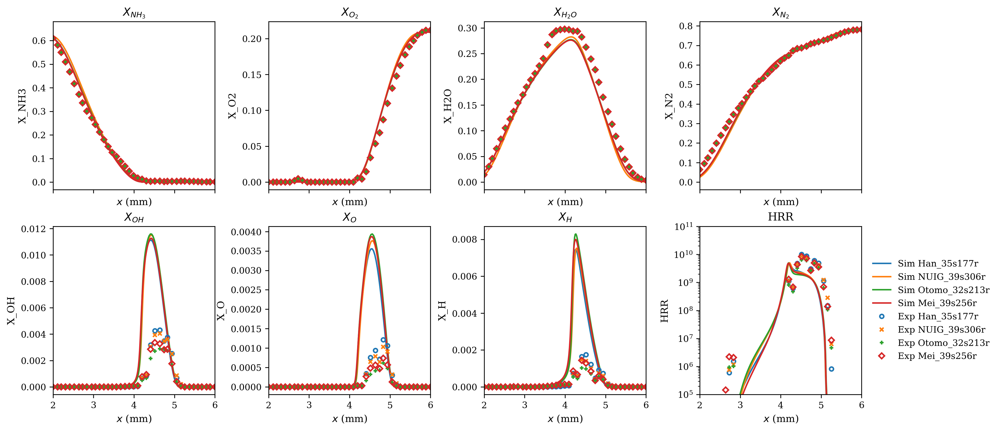

In [2]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# ─── Publication‐quality global settings ────────────────────────────────
plt.rcParams.update({
    "font.family":     "serif",
    "font.size":       10,
    "axes.titlesize":  11,
    "axes.labelsize":  10,
    "xtick.labelsize": 9,
    "ytick.labelsize": 9,
    "legend.fontsize": 9,
    "lines.linewidth": 1.2,
    "lines.markersize": 4,
    "figure.dpi":      300,
})

# ─── Constants ────────────────────────────────────────────────────────────
cases_names = [
    "N_0", "N_08", "N_16", "N_24", "N_30",
    "AH82", "AH64", "AH46",
    "AH64_K80", "AH64_K120", "AH64_K140"
]
exp_shifts = [2.4, 2.5, 2.65, 2.76, 2.85, 2.9, 2.45, 2.35, 2.4, 2.75, 2.85]
sim_shifts = [-2.0] * len(cases_names)

mechanisms = ["Han_35s177r", "NUIG_39s306r", "Otomo_32s213r", "Mei_39s256r"]
tab10      = plt.get_cmap('tab10').colors
markers    = ['o', 'x', '+', 'D']

# variables & titles (2 rows of 4)
row1      = ["X_NH3", "X_O2",  "X_H2O", "X_N2"]
row2      = ["X_OH",  "X_O",   "X_H",   "HRR"]
variables = row1 + row2
titles    = [
    r"$X_{NH_3}$", r"$X_{O_2}$", r"$X_{H_2O}$", r"$X_{N_2}$",
    r"$X_{OH}$",   r"$X_{O}$",   r"$X_{H}$",    "HRR"
]

# base paths
EXP_ROOT = os.path.join("figs", "QSSA", "EXP_data", "NH3_NP_CF_EXP")
SIM_ROOT = os.path.join(
    "/data/ZhuXu/Cantera/NeuralRecon/figs/QSSA/SIM_results",
    "NH3_NP_CF_reduce"
)

def plot_case(case_name: str):
    """Loads exp+sim data for `case_name`, makes 2×4 plot, saves PDF."""
    # compute shifts
    idx = cases_names.index(case_name)
    shift_exp = exp_shifts[idx]
    shift_sim = sim_shifts[idx]

    # load all sim CSVs for this case
    sim_dfs = {}
    sim_case_dir = os.path.join(SIM_ROOT, case_name)
    for mech in mechanisms:
        fn = os.path.join(sim_case_dir, mech, "predicted_X.csv")
        try:
            sim_dfs[mech] = pd.read_csv(fn)
        except Exception:
            sim_dfs[mech] = None

    # set up figure
    fig, axes = plt.subplots(2, 4, figsize=(14, 6), sharex=True)
    axes_flat = axes.flatten()

    for ax, var, title in zip(axes_flat, variables, titles):
        # 1) sim lines
        for j, mech in enumerate(mechanisms):
            df_sim = sim_dfs[mech]
            if df_sim is not None and var in df_sim.columns:
                x_sim = df_sim['grid'] * 1e3 + shift_sim
                ax.plot(
                    x_sim, df_sim[var],
                    linestyle='-',
                    linewidth=1.5,
                    color=tab10[j],
                    label=f"Sim {mech}"
                )

        # 2) exp markers
        exp_case_dir = os.path.join(EXP_ROOT, case_name)
        for j, mech in enumerate(mechanisms):
            fn = os.path.join(exp_case_dir, mech, "predicted_X.csv")
            try:
                df_exp = pd.read_csv(fn)
                x_exp = df_exp['x'] + shift_exp
                ax.plot(
                    x_exp, df_exp[var],
                    linestyle='',
                    marker=markers[j],
                    markersize=4,
                    markeredgewidth=1.5,
                    markeredgecolor=tab10[j],
                    markerfacecolor='none',
                    label=f"Exp {mech}"
                )
            except Exception:
                pass

        # styling
        ax.set_title(title)
        ax.set_xlabel("$x$ (mm)")
        ax.set_ylabel(var)
        ax.grid(False)
        ax.set_xlim(2, 6)
        if var == "HRR":
            ax.set_yscale('log')
            ax.set_ylim(1e5, 1e11)

    # shared legend on bottom‐right subplot
    handles, labels = axes_flat[-1].get_legend_handles_labels()
    axes_flat[-1].legend(
        handles, labels,
        loc='center left',
        bbox_to_anchor=(1.02, 0.5),
        frameon=False
    )

    plt.tight_layout(pad=0.5)
    out_pdf = os.path.join(EXP_ROOT, case_name, f"comparison_2x4_{case_name}.png")
    plt.savefig(out_pdf, format='pdf', bbox_inches='tight')
    print(f"[{case_name}] saved to {out_pdf}")

# ─── Loop over all cases ───────────────────────────────────────────────────
for case in cases_names:
    plot_case(case)

# What about  considering the relative error in NH3?

[N_0] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/N_0/comparison_2x4_N_0_log.png
[N_08] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/N_08/comparison_2x4_N_08_log.png
[N_16] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/N_16/comparison_2x4_N_16_log.png
[N_24] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/N_24/comparison_2x4_N_24_log.png
[N_30] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/N_30/comparison_2x4_N_30_log.png
[AH82] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH82/comparison_2x4_AH82_log.png
[AH64] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH64/comparison_2x4_AH64_log.png
[AH46] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH46/comparison_2x4_AH46_log.png
[AH64_K80] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH64_K80/comparison_2x4_AH64_K80_log.png
[AH64_K120] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH64_K120/comparison_2x4_AH64_K120_log.png
[AH64_K140] saved to figs/QSSA/EXP_data/NH3_NP_CF_EXP/AH64_K140/comparison_2x4_AH64_K140_log.png


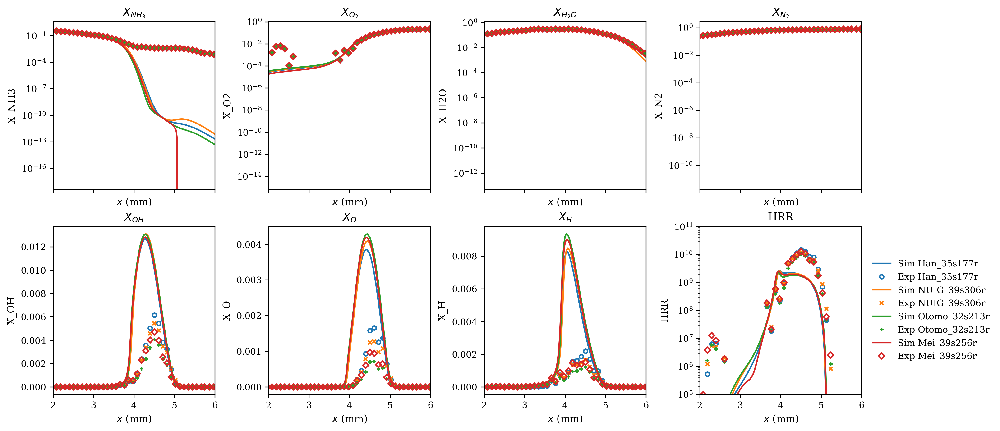

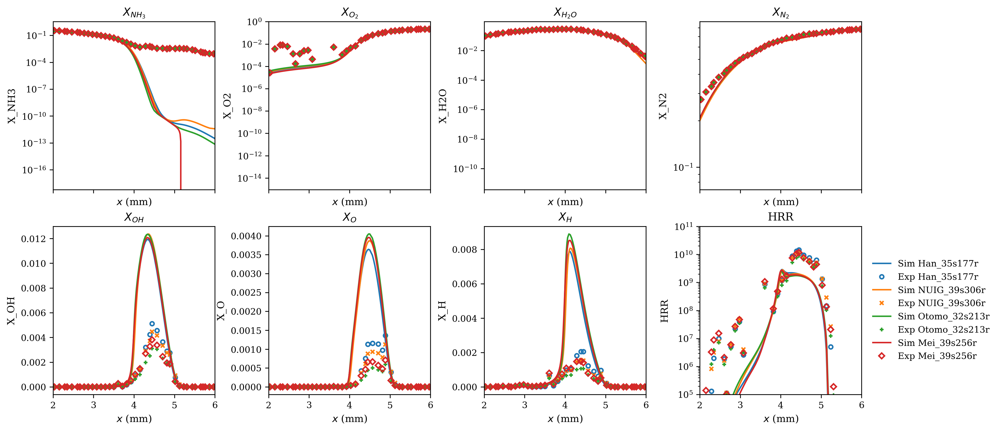

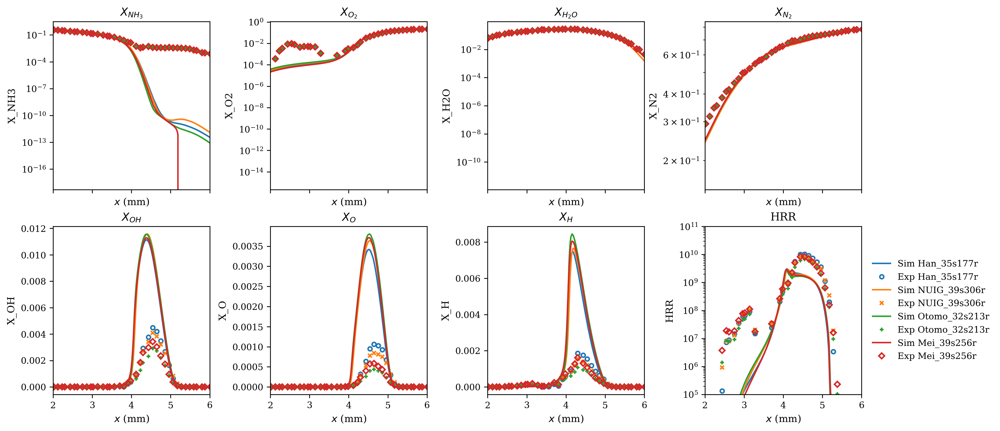

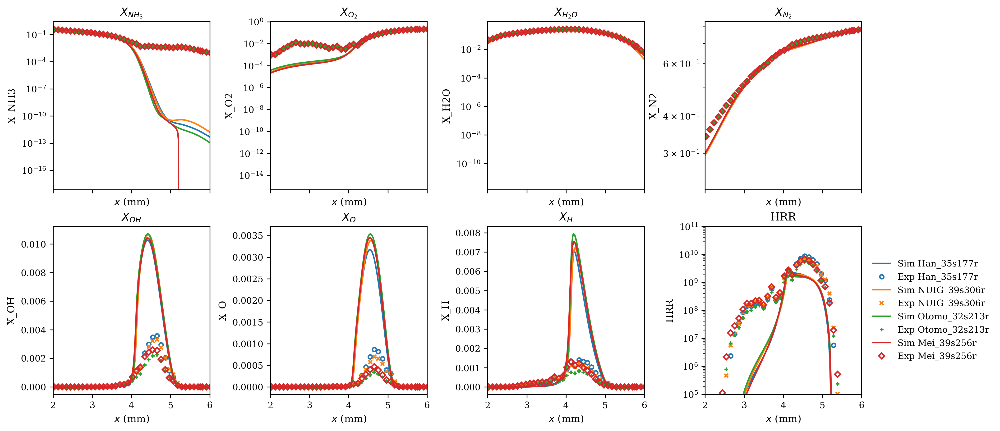

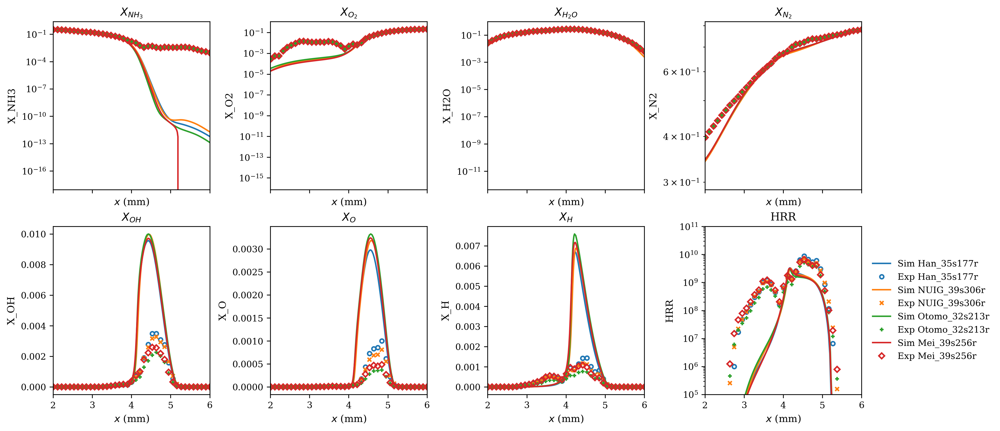

...

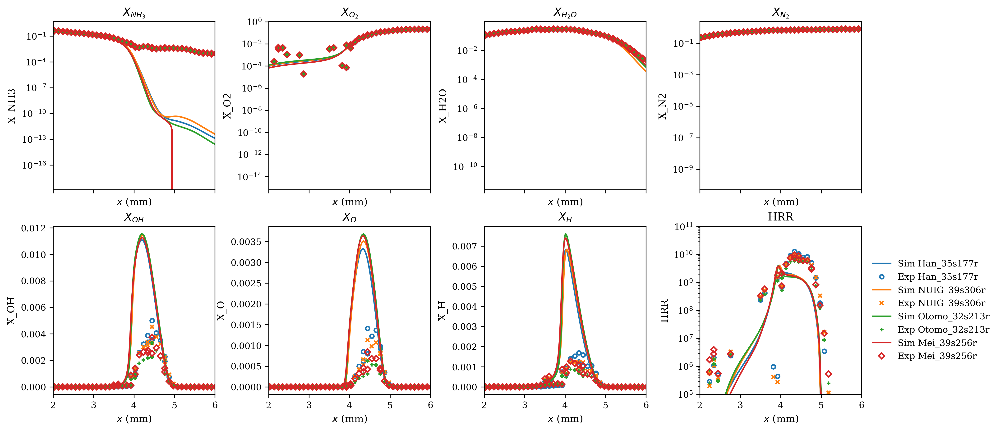

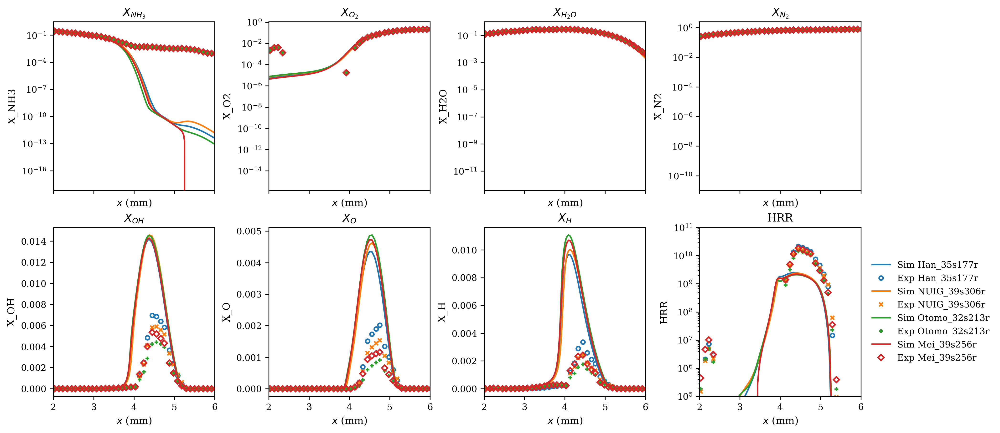

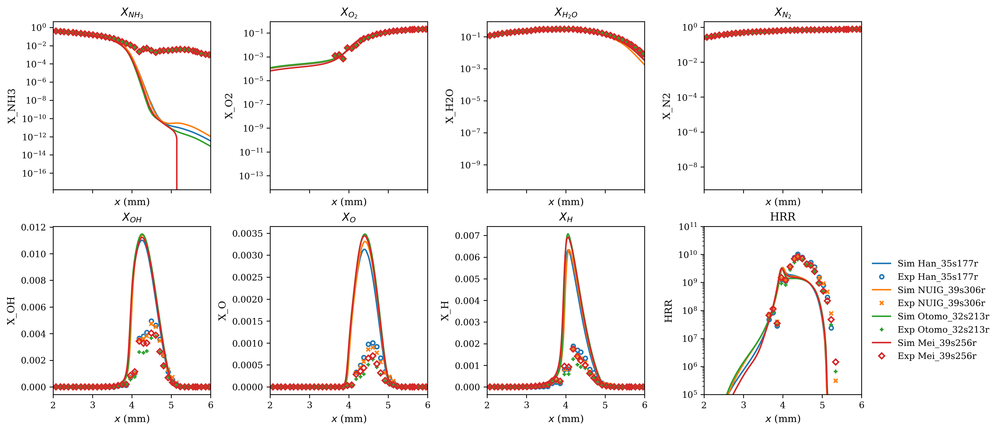

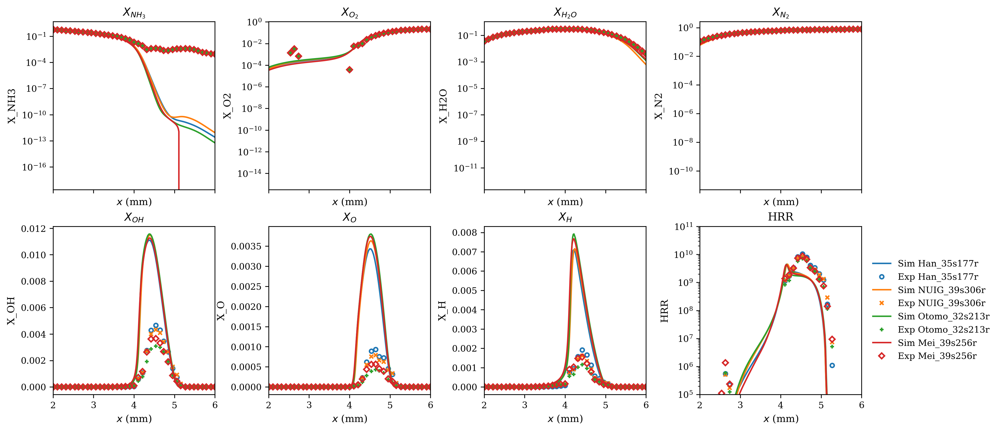

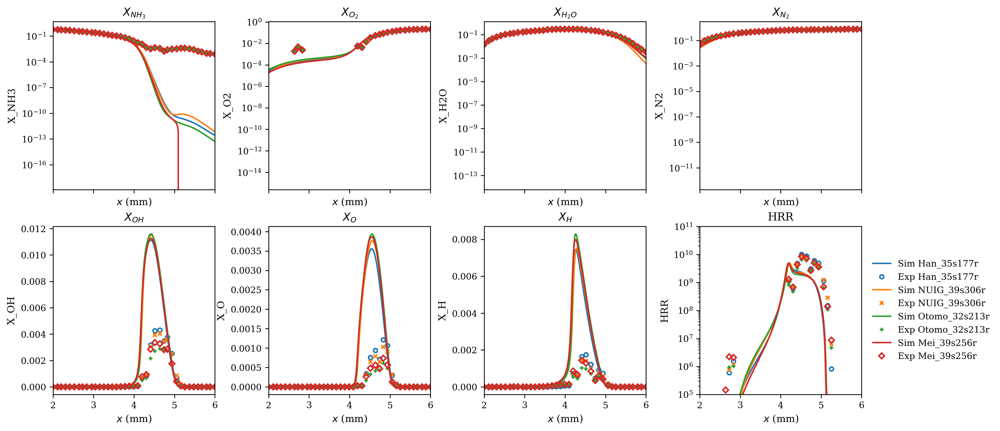

In [4]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# ─── Publication‐quality global settings ────────────────────────────────
plt.rcParams.update({
    "font.family":     "serif",
    "font.size":       10,
    "axes.titlesize":  11,
    "axes.labelsize":  10,
    "xtick.labelsize": 9,
    "ytick.labelsize": 9,
    "legend.fontsize": 9,
    "lines.linewidth": 1.2,
    "lines.markersize": 4,
    "figure.dpi":      300,
})

# ─── Constants ────────────────────────────────────────────────────────────
cases_names = [
    "N_0", "N_08", "N_16", "N_24", "N_30",
    "AH82", "AH64", "AH46",
    "AH64_K80", "AH64_K120", "AH64_K140"
]
exp_shifts = [2.4, 2.5, 2.65, 2.76, 2.85, 2.9, 2.45, 2.35, 2.4, 2.75, 2.85]
sim_shifts = [-2.0] * len(cases_names)

mechanisms = ["Han_35s177r", "NUIG_39s306r", "Otomo_32s213r", "Mei_39s256r"]
tab10      = plt.get_cmap('tab10').colors
markers    = ['o', 'x', '+', 'D']

EXP_ROOT = os.path.join("figs", "QSSA", "EXP_data", "NH3_NP_CF_EXP")
SIM_ROOT = os.path.join(
    "/data/ZhuXu/Cantera/NeuralRecon/figs/QSSA/SIM_results",
    "NH3_NP_CF_reduce"
)

# ─── define two rows ──────────────────────────────────────────────────────
row1_vars = ["X_NH3", "X_O2",  "X_H2O", "X_N2"]
row3_vars = ["X_OH",  "X_O",   "X_H",   "HRR"]

row1_titles = [r"$X_{NH_3}$", r"$X_{O_2}$", r"$X_{H_2O}$", r"$X_{N_2}$"]
row3_titles = [r"$X_{OH}$",   r"$X_{O}$",    r"$X_{H}$",    "HRR"]

variables = row1_vars + row3_vars
titles    = row1_titles + row3_titles

def plot_case(case_name: str):
    # look up shifts
    idx = cases_names.index(case_name)
    shift_exp = exp_shifts[idx]
    shift_sim = sim_shifts[idx]

    # preload sim data
    sim_dfs = {}
    sim_case_dir = os.path.join(SIM_ROOT, case_name)
    for mech in mechanisms:
        fn = os.path.join(sim_case_dir, mech, "predicted_X.csv")
        try:
            sim_dfs[mech] = pd.read_csv(fn)
        except Exception:
            sim_dfs[mech] = None

    # 2×4 layout now
    fig, axes = plt.subplots(2, 4, figsize=(14, 6), sharex=True)
    axes_flat = axes.flatten()

    for ax, var, title in zip(axes_flat, variables, titles):
        # sim + exp plotting
        for j, mech in enumerate(mechanisms):
            color = tab10[j]

            # sim line
            df_sim = sim_dfs[mech]
            if df_sim is not None and var in df_sim.columns:
                x_sim = df_sim['grid'] * 1e3 + shift_sim
                ax.plot(
                    x_sim, df_sim[var],
                    linestyle='-',
                    linewidth=1.5,
                    color=color,
                    label=f"Sim {mech}"
                )

            # exp markers
            exp_f = os.path.join(EXP_ROOT, case_name, mech, "predicted_X.csv")
            try:
                df_exp = pd.read_csv(exp_f)
                if var in df_exp.columns:
                    x_exp = df_exp['x'] + shift_exp
                    ax.plot(
                        x_exp, df_exp[var],
                        linestyle='',
                        marker=markers[j],
                        markersize=4,
                        markeredgewidth=1.5,
                        markeredgecolor=color,
                        markerfacecolor='none',
                        label=f"Exp {mech}"
                    )
            except Exception:
                pass

        # styling
        ax.set_title(title)
        ax.set_xlabel("$x$ (mm)")
        ax.set_ylabel(var)
        ax.grid(False)
        ax.set_xlim(2, 6)

        # log‐scale first row and HRR
        row = axes_flat.tolist().index(ax) // 4
        if row == 0 or var == "HRR":
            ax.set_yscale('log')
            if var == "HRR":
                ax.set_ylim(1e5, 1e11)

    # legend on bottom‐right plot
    handles, labels = axes_flat[-1].get_legend_handles_labels()
    axes_flat[-1].legend(
        handles, labels,
        loc='center left',
        bbox_to_anchor=(1.02, 0.5),
        frameon=False
    )

    plt.tight_layout(pad=0.5)
    out_pdf = os.path.join(EXP_ROOT, case_name, f"comparison_2x4_{case_name}_log.png")
    plt.savefig(out_pdf, format='pdf', bbox_inches='tight')
    print(f"[{case_name}] saved to {out_pdf}")

# ─── Loop over all cases ───────────────────────────────────────────────────
for case in cases_names:
    plot_case(case)

In [29]:
#!/usr/bin/env python3
"""
Batch-align EXP HRR to SIM grid for multiple cases *and* mechanisms
by shifting EXP x by (exp_shift + 2) [mm], then interpolating onto the SIM grid.

Conventions
-----------
• SIM coordinate is read from SIM CSV (meters) and converted to millimeters.
• EXP coordinate is assumed to be in millimeters, then shifted by (exp_shift + 2).
• Interpolation: numpy.interp (edge-clamp outside EXP domain).

Inputs
------
SIM CSV per (case, mech):
  SIM_results/<SIM_CASE_DIR>/<MECH>/<case>.csv
  needs: coordinate ['grid'|'x'|'X'] and 'HRR'

EXP CSV per (case, mech):
  figs/QSSA/EXP_data/NH3_NP_CF_EXP/<case>/<MECH>/predicted_X.csv
  needs: 'x' (mm) and 'HRR'

Outputs
-------
Aligned CSV per (case, mech):
  figs/QSSA/EXP_data/NH3_NP_CF_EXP_shifted/<case>/<MECH>/<case>.csv
  columns: ['grid_mm', 'HRR_sim', 'HRR']

Optional diagnostics (overlay plot):
  figs/QSSA/EXP_data/NH3_NP_CF_EXP_shifted/_diagnostics/<case>/<MECH>/<case>__overlay.png
"""

import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ─── User settings ─────────────────────────────────────────────────────────────
SIM_DATA_ROOT   = "SIM_results"          # root containing simulation case folders
SIM_CASE_DIR    = "NH3_NP_CF_reduce"     # subfolder under SIM_DATA_ROOT

# Process these mechanisms under each case directory
MECHs = ["Han_35s177r", "Marshall_33s221r", "Mei_39s256r", "NUIG_39s306r", "Otomo_32s213r"]

# EXP data root (each case has its own folder containing MECH/predicted_X.csv)
EXP_DATA_ROOT   = os.path.join("figs", "QSSA", "EXP_data", "NH3_NP_CF_EXP_assist_NH3")

# Output directory for aligned CSVs (and optional diagnostics)
OUT_DIR         = os.path.join("figs", "QSSA", "EXP_data", "NH3_NP_CF_EXP_assist_NH3_shifted")

# Cases and per-case shifts
cases_names = [
    "N_0", "N_08", "N_16", "N_24", "N_30",
    "AH82", "AH64", "AH46",
    "AH64_K80", "AH64_K120", "AH64_K140"
]
exp_shifts = [2.4, 2.5, 2.65, 2.76, 2.85, 2.9, 2.45, 2.35, 2.4, 2.75, 2.85]
# Directly add +2 to the shifts (mm)
exp_shifts = np.array(exp_shifts, dtype=float) + 2.0

# Optional: make a quick overlay plot per (case, mech)
DIAG_PLOTS = True

# ─── Path templates ────────────────────────────────────────────────────────────
def sim_csv_path(case: str, mech: str) -> str:
    return os.path.join(SIM_DATA_ROOT, SIM_CASE_DIR, mech, f"{case}.csv")

def exp_csv_path(case: str, mech: str) -> str:
    # As requested: <EXP_DATA_ROOT>/<case>/<MECH>/predicted_X.csv
    return os.path.join(EXP_DATA_ROOT, case, mech, "predicted_X.csv")

def out_csv_path(case: str, mech: str) -> str:
    # Save as .../<case>/<MECH>/<case>.csv  (filename is just the case)
    return os.path.join(OUT_DIR, case, mech, f"{case}.csv")

def diag_plot_path(case: str, mech: str) -> str:
    return os.path.join(OUT_DIR, "_diagnostics", case, mech, f"{case}__overlay.png")

# ─── Helpers ──────────────────────────────────────────────────────────────────
def pick_coord_column(df: pd.DataFrame, preferred: str, fallbacks=None) -> str:
    if preferred in df.columns:
        return preferred
    for c in (fallbacks or []):
        if c in df.columns:
            return c
    raise KeyError(
        f"None of the coordinate columns found. Looked for '{preferred}' or {fallbacks}. "
        f"Available columns: {list(df.columns)}"
    )

def load_sim(case: str, mech: str):
    """Load SIM; convert coordinate from meters → millimeters."""
    path = sim_csv_path(case, mech)
    if not os.path.isfile(path):
        raise FileNotFoundError(f"SIM file not found: {path}")
    df = pd.read_csv(path)
    xcol = pick_coord_column(df, "grid", ["x", "X"])
    if "HRR" not in df.columns:
        raise KeyError(f"'HRR' column not found in SIM file: {path}")
    x_m  = df[xcol].to_numpy()
    x_mm = x_m * 1000.0
    y    = df["HRR"].to_numpy()
    return x_mm, y, path, f"{xcol} (mm)"

def load_exp(case: str, mech: str):
    """Load EXP; coordinate assumed already in millimeters."""
    path = exp_csv_path(case, mech)
    if not os.path.isfile(path):
        raise FileNotFoundError(f"EXP file not found: {path}")
    df = pd.read_csv(path)
    xcol = pick_coord_column(df, "x", ["X"])
    if "HRR" not in df.columns:
        raise KeyError(f"'HRR' column not found in EXP file: {path}")
    # Clean/sort; collapse duplicates
    df = df[[xcol, "HRR"]].replace([np.inf, -np.inf], np.nan).dropna().sort_values(by=xcol)
    df = df.groupby(xcol, as_index=False)["HRR"].mean()
    return df[xcol].to_numpy(), df["HRR"].to_numpy(), path, f"{xcol} (mm)"

def interp_exp_to_sim(sim_x_mm: np.ndarray, exp_x_mm: np.ndarray, exp_y: np.ndarray) -> np.ndarray:
    """Interpolate EXP HRR (mm) onto SIM grid (mm). Edge-clamp outside EXP domain."""
    order = np.argsort(exp_x_mm)
    xx = exp_x_mm[order]
    yy = exp_y[order]
    return np.interp(sim_x_mm, xx, yy)

# ─── Main batch ────────────────────────────────────────────────────────────────
def main():
    os.makedirs(OUT_DIR, exist_ok=True)

    summary_rows = []
    if len(cases_names) != len(exp_shifts):
        raise ValueError("cases_names and exp_shifts lengths differ.")

    for i, case in enumerate(cases_names):
        shift_val = float(exp_shifts[i])  # already includes +2.0 (mm)

        for mech in MECHs:
            # Prepare per-(case, mech) output dirs
            os.makedirs(os.path.dirname(out_csv_path(case, mech)), exist_ok=True)
            if DIAG_PLOTS:
                os.makedirs(os.path.dirname(diag_plot_path(case, mech)), exist_ok=True)

            # Load inputs
            try:
                sim_x_mm, sim_hrr, sim_path, sim_xname = load_sim(case, mech)
            except Exception as e:
                print(f"[{case} | {mech}] SKIP (SIM load error): {e}")
                continue
            try:
                exp_x_mm, exp_hrr, exp_path, exp_xname = load_exp(case, mech)
            except Exception as e:
                print(f"[{case} | {mech}] SKIP (EXP load error): {e}")
                continue

            # Shift EXP only (in mm)
            exp_x_shifted_mm = exp_x_mm + shift_val

            # Interpolate EXP HRR → SIM grid
            exp_hrr_interp = interp_exp_to_sim(sim_x_mm, exp_x_shifted_mm, exp_hrr)

            # Save aligned CSV as "<case>.csv" inside <case>/<MECH>/
            out_df = pd.DataFrame({
                "grid_mm": sim_x_mm,
                "HRR_sim": sim_hrr,
                "HRR": exp_hrr_interp
            })
            out_path = out_csv_path(case, mech)
            out_df.to_csv(out_path, index=False)

            # Diagnostics
            sim_range = (float(np.min(sim_x_mm)), float(np.max(sim_x_mm)))
            exp_range = (float(np.min(exp_x_shifted_mm)), float(np.max(exp_x_shifted_mm)))
            coverage_note = ""
            if exp_range[0] > sim_range[0] or exp_range[1] < sim_range[1]:
                coverage_note = " (WARNING: EXP domain does not fully cover SIM; edge clamp used)"

            print(f"[{case} | {mech}] saved: {out_path}")
            print(f"    SIM {sim_xname} range (mm): {sim_range}")
            print(f"    EXP {exp_xname}+shift range (mm): {exp_range}{coverage_note}")

            summary_rows.append({
                "case": case,
                "mech": mech,
                "shift_applied_mm": shift_val,
                "sim_coord_min_mm": sim_range[0],
                "sim_coord_max_mm": sim_range[1],
                "exp_shifted_min_mm": exp_range[0],
                "exp_shifted_max_mm": exp_range[1],
                "edge_clamp": (exp_range[0] > sim_range[0]) or (exp_range[1] < sim_range[1])
            })

            if DIAG_PLOTS:
                plt.figure(figsize=(4, 3))
                plt.plot(sim_x_mm, sim_hrr,             label="SIM HRR (truth)")
                plt.plot(exp_x_shifted_mm, exp_hrr,     label="EXP HRR (shifted)", linewidth=1, alpha=0.85)
                plt.plot(sim_x_mm, exp_hrr_interp, '--', label="EXP→SIM (interp)", linewidth=1)
                plt.xlabel("x (mm)")
                plt.ylabel("HRR")
                plt.title(f"{case} | {mech}")
                plt.legend(frameon=False, fontsize=8)
                plt.tight_layout()
                plt.savefig(diag_plot_path(case, mech), dpi=200)
                plt.close()

    # Write a small summary CSV at OUT_DIR
    if summary_rows:
        pd.DataFrame(summary_rows).to_csv(os.path.join(OUT_DIR, "_summary.csv"), index=False)

if __name__ == "__main__":
    main()

[N_0 | Han_35s177r] saved: figs/QSSA/EXP_data/NH3_NP_CF_EXP_assist_NH3_shifted/N_0/Han_35s177r/N_0.csv
    SIM grid (mm) range (mm): (0.0, 10.0)
    EXP x (mm)+shift range (mm): (2.593481982, 8.708580627) (WARNING: EXP domain does not fully cover SIM; edge clamp used)
[N_0 | Marshall_33s221r] saved: figs/QSSA/EXP_data/NH3_NP_CF_EXP_assist_NH3_shifted/N_0/Marshall_33s221r/N_0.csv
    SIM grid (mm) range (mm): (0.0, 10.0)
    EXP x (mm)+shift range (mm): (2.593481982, 8.708580627) (WARNING: EXP domain does not fully cover SIM; edge clamp used)
[N_0 | Mei_39s256r] saved: figs/QSSA/EXP_data/NH3_NP_CF_EXP_assist_NH3_shifted/N_0/Mei_39s256r/N_0.csv
    SIM grid (mm) range (mm): (0.0, 10.0)
    EXP x (mm)+shift range (mm): (2.593481982, 8.708580627) (WARNING: EXP domain does not fully cover SIM; edge clamp used)
[N_0 | NUIG_39s306r] saved: figs/QSSA/EXP_data/NH3_NP_CF_EXP_assist_NH3_shifted/N_0/NUIG_39s306r/N_0.csv
    SIM grid (mm) range (mm): (0.0, 10.0)
    EXP x (mm)+shift range (mm): (2.

# Consider the NH3 addition in Exp

<ipython-input-30-3f0bffaacb83>:162: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=[0.02, 0.02, 1, 0.92])


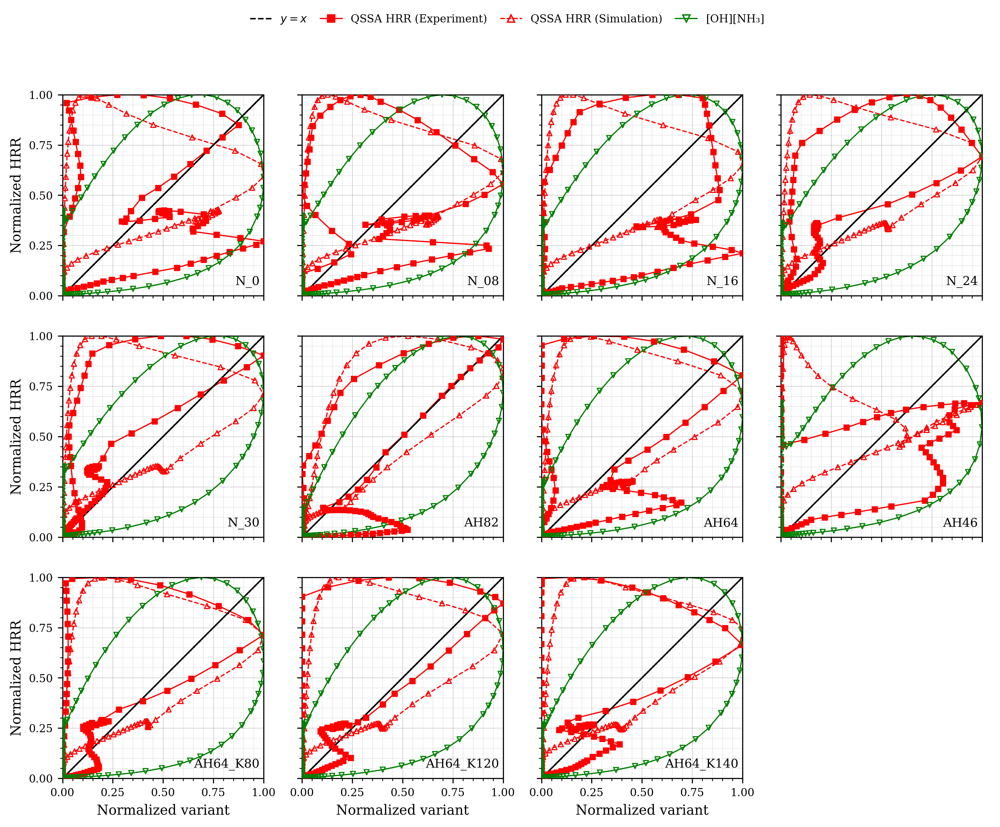

→ Saved: figs/validation/HRR_vs_variants_3x4_qssa_distinguished.pdf
→ Saved: figs/validation/HRR_vs_variants_3x4_qssa_distinguished.png


In [30]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# ─── User settings ─────────────────────────────────────────────────────────────
SIM_data_path       = "SIM_results"
EXP_data_path       = "EXP_data"
exp_qssa_recon_path = "NH3_NP_CF_EXP_assist_NH3_shifted"
sim_qssa_case_name  = "NH3_NP_CF_reduce"
# mech                = "Han_35s177r" 
mech                = "Otomo_32s213r"


# 11 target cases (3×4 grid; one empty)
target_cases = [
    "N_0", "N_08", "N_16", "N_24", "N_30",
    "AH82", "AH64", "AH46",
    "AH64_K80", "AH64_K120", "AH64_K140"
]

# ─── Matplotlib styling for paper quality ──────────────────────────────────────
plt.rcParams.update({
    "font.family": "serif",
    "font.size": 9,
    "axes.labelsize": 10,
    "axes.titlesize": 10,
    "legend.fontsize": 8,
    "xtick.labelsize": 8,
    "ytick.labelsize": 8,
    "savefig.dpi": 300
})

# Each entry: (legend_label, linestyle, color, marker, markerfilled?)
series_info = [
    ("$y = x$",                 "--", "k",  None, False),
    ("QSSA HRR (Experiment)",   "-",  "r",  "s",  True),   # solid red, filled squares
    ("QSSA HRR (Simulation)",   "--", "r",  "^",  False),  # dashed red, hollow triangles
    ("[OH][NH₃]",               "-",  "g",  "v",  False),  # green, hollow down-triangles
]

# ─── Layout ────────────────────────────────────────────────────────────────────
n_rows, n_cols = 3, 4
fig, axes = plt.subplots(
    n_rows, n_cols, figsize=(3.1 * n_cols, 3.1 * n_rows),
    sharex=True, sharey=True,
    gridspec_kw={"hspace": 0.2, "wspace": 0.1}
)
axes = axes.flatten()

def plot_one_subplot(ax, target_case):
    # 1) Load SIM data
    sim_csv = os.path.join(SIM_data_path, sim_qssa_case_name, mech, f"{target_case}.csv")
    if not os.path.isfile(sim_csv):
        raise FileNotFoundError(f"Simulation file not found:\n{sim_csv}")
    df_sim = pd.read_csv(sim_csv)

    # 2) Load QSSA from “Experiments”
    exp_qssa_csv = os.path.join(
        "figs", "QSSA", EXP_data_path, exp_qssa_recon_path, target_case, mech, f"{target_case}.csv"
    )
    if not os.path.isfile(exp_qssa_csv):
        raise FileNotFoundError(f"QSSA (exp) file not found:\n{exp_qssa_csv}")
    df_qssa1 = pd.read_csv(exp_qssa_csv)

    # 3) Load QSSA from “Simulations”
    sim_qssa_csv = os.path.join(
        "figs", "QSSA", SIM_data_path, sim_qssa_case_name, target_case, mech, "predicted_X.csv"
    )
    if not os.path.isfile(sim_qssa_csv):
        raise FileNotFoundError(f"QSSA (sim) file not found:\n{sim_qssa_csv}")
    df_qssa2 = pd.read_csv(sim_qssa_csv)

    # 4) Prepare SIM HRR (normalized)
    sim_hrr      = df_sim["HRR"].to_numpy()
    sim_hrr_norm = sim_hrr / np.max(sim_hrr)

    # 5) Build the (x, y) pairs in the same order as series_info
    variants = []
    # (a) y = x
    variants.append((sim_hrr_norm, sim_hrr_norm))
    # (b) QSSA HRR (Experiment)
    qssa1_hrr_norm = df_qssa1["HRR"].to_numpy()
    qssa1_hrr_norm = qssa1_hrr_norm / np.max(qssa1_hrr_norm)
    variants.append((qssa1_hrr_norm, sim_hrr_norm))
    # (c) QSSA HRR (Simulation)
    qssa2_hrr_norm = df_qssa2["HRR"].to_numpy()
    qssa2_hrr_norm = qssa2_hrr_norm / np.max(qssa2_hrr_norm)
    variants.append((qssa2_hrr_norm, sim_hrr_norm))
    # (d) [OH][NH3] from SIM
    prod_oh_nh3_norm = (df_sim["X_OH"].to_numpy() * df_sim["X_NH3"].to_numpy())
    prod_oh_nh3_norm = prod_oh_nh3_norm / np.max(prod_oh_nh3_norm)
    variants.append((prod_oh_nh3_norm, sim_hrr_norm))

    # 6) Plot – paper quality
    for (label, ls, color, marker, filled), (x_arr, y_arr) in zip(series_info, variants):
        if marker is None:
            ax.plot(x_arr, y_arr, linestyle=ls, color=color, linewidth=1.1, zorder=2, label=label)
        else:
            ax.plot(x_arr, y_arr, linestyle=ls, color=color, linewidth=0.9, zorder=1)
            ax.scatter(
                x_arr, y_arr,
                s=14,
                marker=marker,
                facecolors=(color if filled else 'none'),
                edgecolors=color,
                linewidths=0.8,
                label=label,
                zorder=3
            )

    # 7) Axes cosmetics
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_aspect('equal', adjustable='box')
    ticks = [0, 0.25, 0.5, 0.75, 1]
    ax.set_xticks(ticks)
    ax.set_yticks(ticks)
    ax.minorticks_on()
    ax.grid(True, which="major", linewidth=0.35, alpha=0.25)
    ax.grid(True, which="minor", linewidth=0.25, alpha=0.15)

    # Labels on left column / bottom row only
    idx = target_cases.index(target_case)
    col_index = idx % n_cols
    row_index = idx // n_cols

    if col_index == 0:
        ax.set_ylabel("Normalized HRR")
    if row_index == n_rows - 1:
        ax.set_xlabel("Normalized variant")

    # Case tag
    ax.text(0.98, 0.04, target_case, transform=ax.transAxes,
            ha='right', va='bottom', fontsize=9)

# ─── Draw subplots ─────────────────────────────────────────────────────────────
for idx_case, target_case in enumerate(target_cases):
    plot_one_subplot(axes[idx_case], target_case)

# Turn off any unused axes (e.g., last one in 3×4)
for k in range(len(target_cases), n_rows*n_cols):
    axes[k].axis("off")

# ─── Legend (single, clean) ───────────────────────────────────────────────────
proxy_handles, proxy_labels = [], []
for (label, ls, color, marker, filled) in series_info:
    if marker is None:
        ph = Line2D([0], [0], linestyle=ls, color=color, linewidth=1.1)
    else:
        ph = Line2D([0], [0], linestyle=ls, color=color, marker=marker,
                    markerfacecolor=(color if filled else 'none'),
                    markeredgecolor=color, markersize=5.5, linewidth=0.9)
    proxy_handles.append(ph)
    proxy_labels.append(label)

fig.legend(proxy_handles, proxy_labels, loc='upper center',
           ncol=len(proxy_handles), frameon=False,
           bbox_to_anchor=(0.5, 0.98), handletextpad=0.8, columnspacing=1.2)

fig.tight_layout(rect=[0.02, 0.02, 1, 0.92])

# Save vector PDF + high-dpi PNG
out_dir = "figs/validation"
os.makedirs(out_dir, exist_ok=True)
pdf_path = os.path.join(out_dir, "HRR_vs_variants_3x4_qssa_distinguished.pdf")
png_path = os.path.join(out_dir, "HRR_vs_variants_3x4_qssa_distinguished.png")
plt.savefig(pdf_path, bbox_inches='tight')
plt.savefig(png_path, dpi=300, bbox_inches='tight')
plt.show()

print(f"→ Saved: {pdf_path}")
print(f"→ Saved: {png_path}")

In [16]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Multi-row / multi-column 1-D counter-flow comparison plotter.

*Distinct* symbols for Exp vs. QSSA now fully parameterized.
"""

import os
from pathlib import Path
from typing import Sequence, Optional, Union, List

import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D


def _as_list(val: Union[float, Sequence[float]], n: int) -> List[float]:
    if isinstance(val, (int, float)):
        return [float(val)] * n
    if len(val) != n:
        raise ValueError("Length of shift lists must match number of cases")
    return list(val)


def plot_counterflow_full(
    mechanism:  str,
    exp_case_dir: str,
    sim_case_dir: str,
    recon_case_dir: Optional[str],
    fig_dir: str,
    target_cases: Sequence[str],
    #
    exp_shift: Union[float, Sequence[float]] = 0.0,
    sim_shift: Union[float, Sequence[float]] = 0.0,
    #
    top_species: Sequence[str] = ("X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"),
    data_species: Sequence[str] = ("X_OH", "X_O", "X_H", "X_NH2", "X_NO", "HRR"),
    #
    x_ranges: Optional[Sequence[Sequence[float]]] = None,
    t_range: Sequence[float] = (500, 2200),
    pdf_name: str = "1D_compact.pdf",
    #
    exp_color: str = "red",
    recon_color: str = "steelblue",
    sim_color: str = "black",
    #
    linewidth: float = 1.0,
    marker_size: float = 8,
    font_size: int = 8,
    #
    exp_marker: str = "o",
    qssa_marker: str = "s",
    top_adjust: float = 0.85,
) -> None:
    """
    exp_marker:     matplotlib marker for experimental points
    qssa_marker:    matplotlib marker for QSSA points
    top_adjust:     top margin for subplots_adjust
    """

    # Pre-compute global y-limits for each species across all cases
    ymins = {sp: float('inf') for sp in top_species + list(data_species)}
    ymaxs = {sp: -float('inf') for sp in top_species + list(data_species)}
    for case in target_cases:
        sim_csv = Path(sim_case_dir) / mechanism / f"{case}.csv"
        exp_csv = Path(exp_case_dir) / case / mechanism / "predicted_X.csv"
        df_sim = pd.read_csv(sim_csv)
        df_exp = pd.read_csv(exp_csv)
        if recon_case_dir:
            recon_csv = Path(recon_case_dir) / case /  mechanism / "predicted_X.csv"
            df_recon = pd.read_csv(recon_csv) if recon_csv.is_file() else None
        else:
            df_recon = None

        for sp in ymins:
            # sim
            if sp in df_sim:
                arr = df_sim[sp].to_numpy()
                ymins[sp] = min(ymins[sp], arr.min())
                ymaxs[sp] = max(ymaxs[sp], arr.max()) * 1.01
            # exp
            if sp in df_exp:
                arr = df_exp[sp].to_numpy()
                if sp == "X_NO": arr = arr / 1e6
                ymins[sp] = min(ymins[sp], arr.min())
                ymaxs[sp] = max(ymaxs[sp], arr.max()) * 1.01
            # recon
            if df_recon is not None and sp in df_recon.columns:
                arr = df_recon[sp].to_numpy()
                ymins[sp] = min(ymins[sp], arr.min())
                ymaxs[sp] = max(ymaxs[sp], arr.max()) * 1.01

    n_cols = len(target_cases)
    exp_shift_l = _as_list(exp_shift, n_cols)
    sim_shift_l = _as_list(sim_shift, n_cols)
    n_rows = len(data_species) + 1

    if x_ranges is None:
        x_ranges = [[None, None]] * n_cols

    plt.rcParams.update({"font.size": font_size})
    fig, axs = plt.subplots(
        n_rows, n_cols,
        figsize=(8.73, 1.1 * n_rows),
        sharex=False, sharey=False
    )

    first_row_handles, first_row_labels = [], []

    for col_idx, case in enumerate(target_cases):
        sim_csv = Path(sim_case_dir) / mechanism / f"{case}.csv"
        exp_csv = Path(exp_case_dir) / case / mechanism / "predicted_X.csv"
        df_sim = pd.read_csv(sim_csv)
        df_exp = pd.read_csv(exp_csv)
        df_recon = None
        if recon_case_dir:
            recon_csv = Path(recon_case_dir) / case /mechanism/ "predicted_X.csv"
            if recon_csv.is_file():
                df_recon = pd.read_csv(recon_csv)

        x_sim = df_sim["grid"].to_numpy() * 1000 + sim_shift_l[col_idx]
        x_exp = df_exp.get("x", df_exp.columns[1]).to_numpy() + exp_shift_l[col_idx]
        x_rec = x_sim

        # ── TOP ROW ─────────────────────────────────
        ax_top = axs[0, col_idx]
        for sp in top_species:
            ln, = ax_top.plot(x_sim, df_sim[sp].to_numpy(), '-', lw=linewidth, color=sim_color)
            sc_exp = ax_top.scatter(x_exp, df_exp[sp].to_numpy(), s=marker_size, marker=exp_marker, lw=linewidth)
            if col_idx == 0:
                first_row_handles.append(sc_exp)
                first_row_labels.append(sp)
        ax_top.set_ylim(0, 1.01)
        ax_top.set_title(case)
        ax_top.set_xticklabels([])
        if col_idx == 0:
            ax_top.set_ylabel('X')
        else:
            ax_top.set_yticks([])
        if x_ranges[col_idx][0] is not None:
            ax_top.set_xlim(*x_ranges[col_idx])

        # ── DATA ROWS ─────────────────────────────
        for r, sp in enumerate(data_species, start=1):
            ax = axs[r, col_idx]
            # sim line
            if sp in df_sim:
                y_sim = df_sim[sp].to_numpy()
                ax.plot(x_sim, y_sim, '-', lw=linewidth, color=sim_color,
                        label='CVODE' if (r==1 and col_idx==0) else '')
            # recon scatter
            if df_recon is not None and sp in df_recon:
                y_rec = df_recon[sp].to_numpy()
                ax.scatter(x_rec[::2], y_rec[::2], s=marker_size, marker=qssa_marker,
                           facecolors='none', edgecolors=recon_color, lw=linewidth,
                           label='QSSA' if (r==1 and col_idx==0) else '')
            # exp scatter
            if sp in df_exp:
                y_exp = df_exp[sp].to_numpy()
                ax.scatter(x_exp, y_exp, s=marker_size, marker=exp_marker,
                           facecolors='none', edgecolors=exp_color, lw=linewidth,
                           label='Exp' if (r==1 and col_idx==0) else '')

           # compute & annotate recon vs sim error
            # compute & annotate both recon & sim vs exp peak errors at top
            if sp in df_exp:
                exp_arr = df_exp[sp].to_numpy().astype(float)
                if df_recon is not None and sp in df_recon:
                    rec_arr = df_recon[sp].to_numpy().astype(float)
                    sim_arr = df_sim[sp].to_numpy().astype(float)
                    
                    err_recon = (rec_arr.max() - sim_arr.max()) / sim_arr.max() * 100
                else:
                    err_recon = None
                # sim error
                if sp in df_sim:
                    sim_arr = df_sim[sp].to_numpy().astype(float)
                    err_exp = (exp_arr.max() - sim_arr.max()) / sim_arr.max() * 100
                else:
                    err_exp = None
 
                # pick left or right
                xloc, ha = (0.95, 'right') if sp == "MF" else (0.05, 'left')
                # y positions for two lines
                y1, y2 = 0.95, 0.85
 
                if err_recon is not None and sp != "CEM" and sp != 'MF':
                    ax.text(xloc, y1,
                            f"Err: {err_recon:.1f}%",
                            transform=ax.transAxes,
                            fontsize=font_size * 0.8,
                            color=recon_color,
                            va='top', ha=ha)
                if err_exp is not None and sp != "CEM" and sp != 'MF':
                    ax.text(xloc, y2,
                            f"Err:   {err_exp:.1f}%",
                            transform=ax.transAxes,
                            fontsize=font_size * 0.8,
                            color=exp_color,
                            va='top', ha=ha) 
            # set y-limits
            if sp!='HRR': ax.set_ylim(ymins[sp],ymaxs[sp])
            else:
                ax.set_yscale('log'); ax.set_ylim(1e6,1e11)

            # twin for T
            if sp=='X_OH' and 'T' in df_sim.columns:
                ax_t=ax.twinx(); ax_t.plot(x_sim,df_sim['T'],':',color='tab:red')
                ax_t.set_ylim(t_range)
                if col_idx==n_cols-1: ax_t.set_ylabel('T (K)',color='tab:red')
                else: ax_t.set_yticks([])
                ax_t.spines['right'].set_color('tab:red')

            if col_idx == 0:
                # format y-labels: species with 'X_' get LaTeX subscripts, HRR gets HRR label
                if sp == 'HRR':
                    ax.set_ylabel('HRR (J/kg/s)', fontsize=font_size)
                elif sp.startswith('X_'):
                    sub = sp.split('_', 1)[1]
                    ax.set_ylabel(f"$X_{{{sub}}}$", fontsize=font_size)
                else:
                    ax.set_ylabel(sp, fontsize=font_size)
            else: ax.set_yticklabels([])
            if r==len(data_species): ax.set_xlabel('x (mm)')
            else: ax.set_xticklabels([])

    # legends
    axs[0,-1].legend(first_row_handles, first_row_labels,loc='upper left',
                     bbox_to_anchor=(1.02,1),frameon=False)
    lg=fig.legend(handles=[
        Line2D([0],[0],color=sim_color,lw=linewidth,label='CVODE'),
        Line2D([0],[0],marker=qssa_marker,linestyle='None',markerfacecolor="none",markeredgecolor=recon_color,label='Sim-based Reconstruction'),
        Line2D([0],[0],marker=exp_marker,linestyle='None',markerfacecolor="none",markeredgecolor=exp_color,label='Exp-based Reconstruction')],
        loc='upper center',ncol=3,bbox_to_anchor=(0.5,1),frameon=False)

    fig.subplots_adjust(top=top_adjust,right=0.85,wspace=0.1,hspace=0.1)
    Path(fig_dir).mkdir(parents=True,exist_ok=True)
    out = Path(fig_dir)/pdf_name; fig.savefig(out,dpi=300,bbox_inches='tight')
    print(f"figure saved → {out}")


In [19]:
mechanims_list = [
    'Han_35s177r',
    'KAUST_32s243r',
    'Marshall_33s221r',
    'Mei_39s256r',
    'NH3_otomo',
]
mechanism = 'Han_35s177r'
# ––––– Case set with individual shifts –––––
plot_counterflow_full(
    mechanism = mechanism,
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["X_OH", "X_O", "X_H", "X_NO"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="1D_compact.pdf",
    exp_marker="o",
    qssa_marker="s",
    top_adjust=0.92,    # lift the title/legend up
    
)

# ––––– Second plot (different species set) –––––
plot_counterflow_full(
    mechanism =  mechanism,
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["MF", "CEM", "HRR"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="1D_compact_CEM.pdf",
    exp_marker="o",
    qssa_marker="s",
    top_adjust=0.88,    # lift the title/legend up
    
)

# ––––– Case set with individual shifts –––––
plot_counterflow_full(
    mechanism = mechanism,
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["X_OH", "X_O", "X_H", "X_NO"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_series_1D_compact.pdf",
    exp_marker="o",
    qssa_marker="s",
    top_adjust=0.92,    # lift the title/legend up
    
)

# ––––– Second plot (different species set) –––––
plot_counterflow_full(
    mechanism =  mechanism,
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["MF", "CEM", "HRR"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_series_1D_compact_CEM.pdf",
    exp_marker="o",
    qssa_marker="s",
    top_adjust=0.88,    # lift the title/legend up
)


FileNotFoundError: [Errno 2] No such file or directory: 'figs/QSSA/EXP_data/NH3_NP_CF_EXP/N_0/Han_35s177r/predicted_X.csv'

# What is Wrong? 
## Why don't we expect good results from the experiments? It could be the noise from the exp, let's try assist some species abtained from detailed mechanism!


## add_O2

In [ ]:
# ––––– Case set with individual shifts –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_O2",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["X_OH", "X_O", "X_H", "X_NO"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="N_series_1D_compact_O2.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.92,    # lift the title/legend up
    
)

# ––––– Second plot (different species set) –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_O2",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["MF", "CEM", "Qdot"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="N_series_1D_compact_CEM_O2.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.88,    # lift the title/legend up
    
)

# ––––– Case set with individual shifts –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_O2",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["X_OH", "X_O", "X_H", "X_NO"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_series_1D_compact_O2.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.92,    # lift the title/legend up
    
)

# ––––– Second plot (different species set) –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_O2",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["MF", "CEM", "Qdot"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_series_1D_compact_CEM_O2.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.88,    # lift the title/legend up
    
)


TypeError: plot_counterflow_full() missing 1 required positional argument: 'mechanism'

figure saved → figs/NH3_NP_CF/N_series_1D_compact_O2_H2O.pdf
figure saved → figs/NH3_NP_CF/N_series_1D_compact_CEM_O2_H2O.pdf
figure saved → figs/NH3_NP_CF/AH_series_1D_compact_O2_H2O.pdf
figure saved → figs/NH3_NP_CF/AH_series_1D_compact_CEM_O2_H2O.pdf


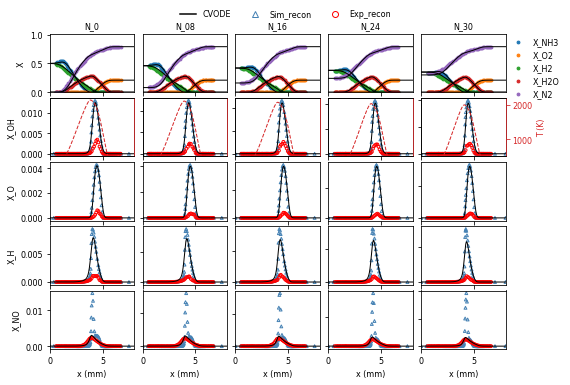

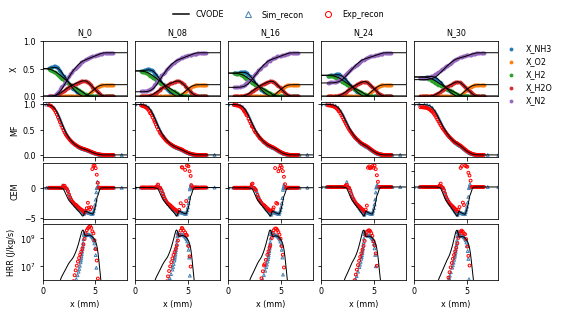

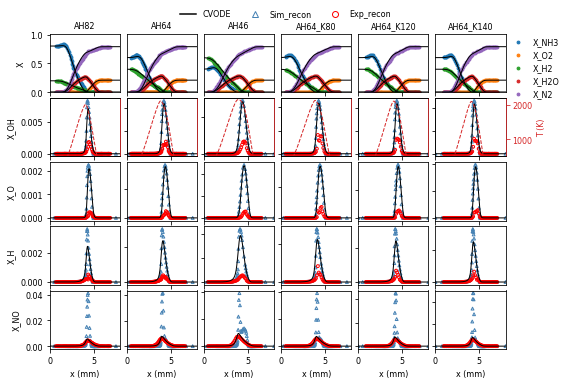

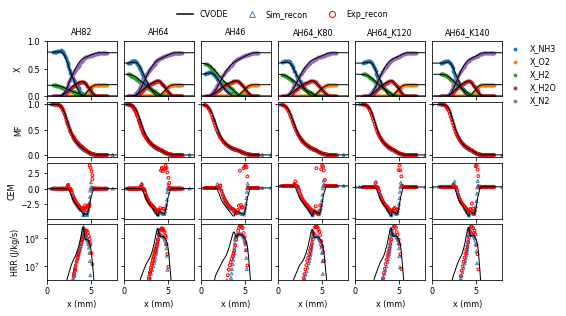

In [ ]:
# ––––– Case set with individual shifts –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_O2_H2O",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["X_OH", "X_O", "X_H", "X_NO"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="N_series_1D_compact_O2_H2O.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.92,    # lift the title/legend up
    
)

# ––––– Second plot (different species set) –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_O2_H2O",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["MF", "CEM", "Qdot"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="N_series_1D_compact_CEM_O2_H2O.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.88,    # lift the title/legend up
    
)

# ––––– Case set with individual shifts –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_O2_H2O",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["X_OH", "X_O", "X_H", "X_NO"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_series_1D_compact_O2_H2O.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.92,    # lift the title/legend up
    
)

# ––––– Second plot (different species set) –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_O2_H2O",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["MF", "CEM", "Qdot"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_series_1D_compact_CEM_O2_H2O.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.88,    # lift the title/legend up
    
)


figure saved → figs/NH3_NP_CF/N_series_1D_compact_NH3.pdf
figure saved → figs/NH3_NP_CF/N_series_1D_compact_CEM_NH3.pdf
figure saved → figs/NH3_NP_CF/AH_series_1D_compact_NH3.pdf
figure saved → figs/NH3_NP_CF/AH_series_1D_compact_CEM_NH3.pdf


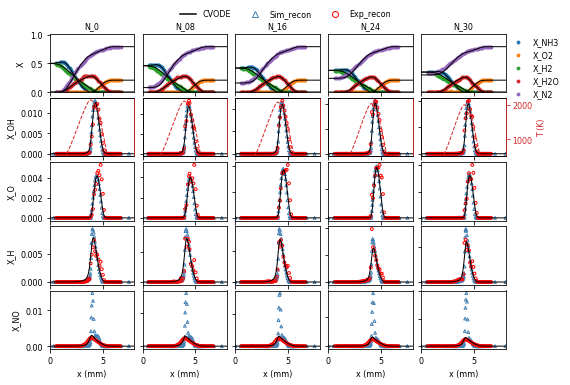

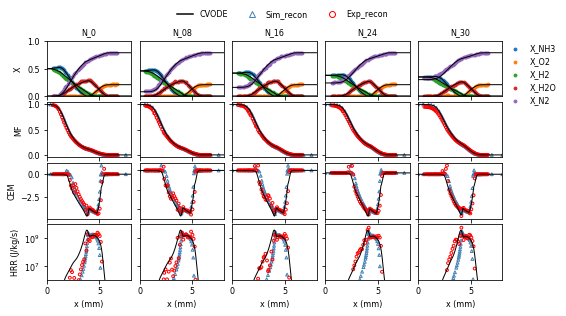

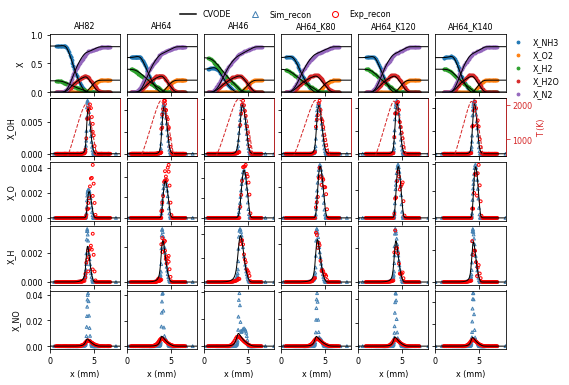

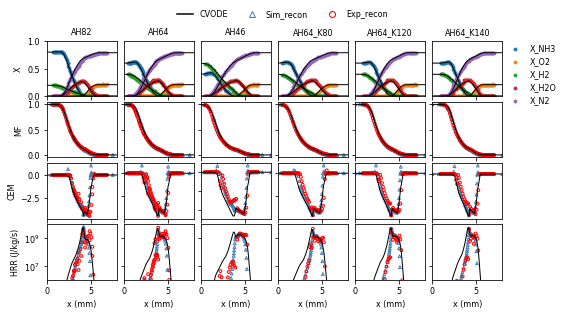

In [ ]:
# ––––– Case set with individual shifts –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_NH3",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["X_OH", "X_O", "X_H", "X_NO"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="N_series_1D_compact_NH3.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.92,    # lift the title/legend up
    
)

# ––––– Second plot (different species set) –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_NH3",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["MF", "CEM", "Qdot"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="N_series_1D_compact_CEM_NH3.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.88,    # lift the title/legend up
    
)
# ––––– Case set with individual shifts –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_NH3",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["X_OH", "X_O", "X_H", "X_NO"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_series_1D_compact_NH3.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.92,    # lift the title/legend up
    
)

# ––––– Second plot (different species set) –––––
plot_counterflow_full(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP_NO_NH3",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["MF", "CEM", "Qdot"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_series_1D_compact_CEM_NH3.pdf",
    exp_marker="o",
    qssa_marker="^",
    top_adjust=0.88,    # lift the title/legend up
    
)

# Plot the influence of adding species

In [ ]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Multi-row / multi-column 1-D counter-flow comparison plotter.

*Distinct* symbols for Exp vs. QSSA now fully parameterized.
"""

import os
from pathlib import Path
from typing import Sequence, Optional, Union, List

import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D


def _as_list(val: Union[float, Sequence[float]], n: int) -> List[float]:
    if isinstance(val, (int, float)):
        return [float(val)] * n
    if len(val) != n:
        raise ValueError("Length of shift lists must match number of cases")
    return list(val)


def plot_counterflow_sim_adding_Species(
    exp_case_dir: str,
    sim_case_dir: str,
    recon_case_dir: Optional[str],
    fig_dir: str,
    target_cases: Sequence[str],
    #
    exp_shift: Union[float, Sequence[float]] = 0.0,
    sim_shift: Union[float, Sequence[float]] = 0.0,
    #
    top_species: Sequence[str] = ("X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"),
    data_species: Sequence[str] = ("X_OH", "X_O", "X_H", "X_NH2", "X_NO", "Qdot"),
    #
    x_ranges: Optional[Sequence[Sequence[float]]] = None,
    t_range: Sequence[float] = (500, 2200),
    pdf_name: str = "1D_compact.pdf",
    #
    exp_color: str = "red",
    recon_color: str = "steelblue",
    sim_color: str = "black",
    #
    linewidth: float = 1.2,
    marker_size: float = 5,
    font_size: int = 8,
    #
    exp_marker: str = "o",
    qssa_marker: str = "s",
    top_adjust: float = 0.85,
) -> None:
    """
    exp_marker:     matplotlib marker for experimental points
    qssa_marker:    matplotlib marker for QSSA points
    top_adjust:     top margin for subplots_adjust
    """

    # Pre-compute global y-limits for each species across all cases
    ymins = {sp: float('inf') for sp in top_species + list(data_species)}
    ymaxs = {sp: -float('inf') for sp in top_species + list(data_species)}
    for case in target_cases:
        exp_csv = Path(exp_case_dir) / case / "predicted_X.csv"
        df_exp = pd.read_csv(exp_csv)
        if recon_case_dir:
            recon_csv = Path(recon_case_dir) / case / "predicted_X.csv"
            df_recon = pd.read_csv(recon_csv) if recon_csv.is_file() else None
        else:
            df_recon = None

        for sp in ymins:
            if sp in df_exp:
                arr = df_exp[sp].to_numpy()
                if sp == "X_NO":
                    arr = arr / 1e6
                ymins[sp] = min(ymins[sp], arr.min())
                ymaxs[sp] = max(ymaxs[sp], arr.max()) * 1.01
            if df_recon is not None and sp in df_recon.columns:
                arr = df_recon[sp].to_numpy()
                ymins[sp] = min(ymins[sp], arr.min())
                ymaxs[sp] = max(ymaxs[sp], arr.max()) * 1.01
                
    n_cols = len(target_cases)
    exp_shift_l = _as_list(exp_shift, n_cols)
    sim_shift_l = _as_list(sim_shift, n_cols)
    n_rows = len(data_species) + 1

    if x_ranges is None:
        x_ranges = [[None, None]] * n_cols

    plt.rcParams.update({"font.size": font_size})
    fig, axs = plt.subplots(
        n_rows, n_cols,
        figsize=(8.73, 1.1 * n_rows),
        sharex=False, sharey=False
    )

    first_row_handles, first_row_labels = [], []

    for col_idx, case in enumerate(target_cases):
        exp_csv = Path(exp_case_dir) / case / "predicted_X.csv"
        sim_csv = Path(sim_case_dir) / f"{case}.csv"
        recon_csv = (Path(recon_case_dir) / case / "predicted_X.csv" if recon_case_dir else None)

        df_exp = pd.read_csv(exp_csv)
        df_sim = pd.read_csv(sim_csv)
        df_recon = pd.read_csv(recon_csv) if recon_csv and Path(recon_csv).is_file() else None

        x_exp = df_exp.get("x", df_exp.columns[1]).to_numpy() + exp_shift_l[col_idx]
        x_rec = df_sim["grid"].to_numpy() * 1000 + sim_shift_l[col_idx]

        # ── TOP ROW ────────────────────────────────────────────────
        ax_top = axs[0, col_idx]
        for sp in top_species:
            sc_exp = ax_top.scatter(
                x_exp, df_exp[sp].to_numpy(),
                s=marker_size, marker=exp_marker, linewidths=linewidth
            )
            if col_idx == 0:
                first_row_handles.append(sc_exp)
                first_row_labels.append(sp)

        ax_top.set_ylim(
            ymins[top_species[0]], ymaxs[top_species[0]]
        ) if len(top_species) == 1 else ax_top.set_ylim(0, 1.01)
        ax_top.set_title(case, fontsize=font_size)
        ax_top.set_xticklabels([])
        if col_idx == 0:
            ax_top.set_ylabel("X", fontsize=font_size)
        else:
            ax_top.set_yticks([])
        xmin, xmax = x_ranges[col_idx]
        if xmin is not None:
            ax_top.set_xlim(xmin, xmax)

        # ── LOWER ROWS ──────────────────────────────────────────────
        for r, sp in enumerate(data_species, start=1):
            ax = axs[r, col_idx]

            # QSSA: line + marker
            if df_recon is not None and sp in df_recon.columns:
                y_rec = df_recon[sp].to_numpy()
                # if sp == "X_NO":
                #     y_rec = y_rec / 1e6
                ax.plot(
                    x_rec, y_rec,
                    linestyle='--', linewidth=linewidth,
                    color= recon_color,
                    label="QSSA" if (r == 1 and col_idx == 0) else ""
                )

            # Experimental: scatter
            if sp in df_exp.columns:
                y_exp = df_exp[sp].to_numpy()
                ax.scatter(
                    x_exp, y_exp,
                    s=marker_size, marker=exp_marker,
                    facecolors='none', edgecolors=exp_color,
                    linewidths=linewidth,
                    label="Exp" if (r == 1 and col_idx == 0) else ""
                )

            # Compute and print relative error at peak
            if df_recon is not None and sp in df_recon.columns and sp in df_exp.columns:
                recon_arr = df_recon[sp].to_numpy()
                exp_arr = df_exp[sp].to_numpy()
                if sp == "X_NO":
                    recon_arr = recon_arr / 1e6
                    exp_arr = exp_arr / 1e6
                recon_peak = recon_arr.max()
                exp_peak = exp_arr.max()
                rel_err = (recon_peak - exp_peak) / exp_peak * 100
                print(f"[{case}][{sp}] Relative peak error: {rel_err:.2f}%")
                
                if sp == "MF":
                    # place in upper-right
                    ax.text(
                        0.95, 0.95,
                        f"Err: {rel_err:.1f}%",
                        transform=ax.transAxes,
                        fontsize=font_size * 0.8,
                        horizontalalignment='right',
                        verticalalignment='top'
                    )
                else:
                    # default: upper-left
                    ax.text(
                        0.05, 0.95,
                        f"Err: {rel_err:.1f}%",
                        transform=ax.transAxes,
                        fontsize=font_size * 0.8,
                        verticalalignment='top'
                    )

            # Apply consistent y-limits
            if sp != "Qdot":
                ax.set_ylim(ymins[sp], ymaxs[sp])

            # Qdot log scale
            if sp == "Qdot":
                ax.set_yscale("log")
                ax.set_ylim(1e6, 1e10)
                y_label = "HRR (J/kg/s)"
            else:
                y_label = sp

            xmin, xmax = x_ranges[col_idx]
            if xmin is not None:
                ax.set_xlim(xmin, xmax)

            if col_idx == 0:
                # format y-labels: species with 'X_' get LaTeX subscripts, Qdot gets HRR label
                if sp == 'Qdot':
                    ax.set_ylabel('HRR (J/kg/s)', fontsize=font_size)
                elif sp.startswith('X_'):
                    sub = sp.split('_', 1)[1]
                    ax.set_ylabel(f"$X_{{{sub}}}$", fontsize=font_size)
                else:
                    ax.set_ylabel(sp, fontsize=font_size)
            else: ax.set_yticklabels([])
            if r == len(data_species):
                ax.set_xlabel("x (mm)", fontsize=font_size)
            else:
                ax.set_xticklabels([])

    # ── LEGENDS & SAVE ─────────────────────────────────────────────
    axs[0, -1].legend(
        first_row_handles, first_row_labels,
        loc="upper left", bbox_to_anchor=(1.02, 1), borderaxespad=0,
        ncol=1, fontsize=font_size, frameon=False
    )

    handles_global = [
        Line2D([0], [0], marker="None", linestyle="-",
               markerfacecolor="none", markeredgecolor=recon_color, label="Sim-based Reconstruction"),
        Line2D([0], [0], marker=exp_marker, linestyle="None",
               markerfacecolor="none", markeredgecolor=exp_color, label="Exp-based Reconstruction"),
    ]
    plt.subplots_adjust(top=top_adjust, right=0.85, wspace=0.1, hspace=0.1)
    fig = plt.gcf()
    fig.legend(
        handles=handles_global, loc="upper center", ncol=2,
        fontsize=font_size, frameon=False, bbox_to_anchor=(0.5, 1)
    )

    Path(fig_dir).mkdir(parents=True, exist_ok=True)
    out_pdf = Path(fig_dir) / pdf_name
    fig.savefig(out_pdf, dpi=300, bbox_inches="tight")
    print(f"figure saved → {out_pdf}")



# ––––– Case set with individual shifts –––––
plot_counterflow_sim_adding_Species(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_NH3",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["NH3_NP_CF_reduce", "NH3_NP_CF_reduce_H2O", "NH3_NP_CF_reduce_O2", "NH3_NP_CF_reduce_N2", "NH3_NP_CF_reduce_NH3"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["X_OH", "X_O", "X_H", "X_NO"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="N_series_1D_compact_NH3.pdf",
    exp_marker="o",
    qssa_marker="s",
    top_adjust=0.92,    # lift the title/legend up
)



# What about change the SIM value to EXP value ? 

[N_0][X_OH] Relative peak error: -29.25%
[N_0][X_O] Relative peak error: -41.00%
[N_0][X_H] Relative peak error: -6.03%
[N_0][X_NO] Relative peak error: -84.39%
[N_08][X_OH] Relative peak error: -25.01%
[N_08][X_O] Relative peak error: -35.60%
[N_08][X_H] Relative peak error: 2.85%
[N_08][X_NO] Relative peak error: -84.84%
[N_16][X_OH] Relative peak error: -25.74%
[N_16][X_O] Relative peak error: -27.16%
[N_16][X_H] Relative peak error: 19.19%
[N_16][X_NO] Relative peak error: -75.61%
[N_24][X_OH] Relative peak error: -24.85%
[N_24][X_O] Relative peak error: -32.53%
[N_24][X_H] Relative peak error: 16.34%
[N_24][X_NO] Relative peak error: -68.60%
[N_30][X_OH] Relative peak error: -23.71%
[N_30][X_O] Relative peak error: -25.90%
[N_30][X_H] Relative peak error: 44.01%
[N_30][X_NO] Relative peak error: -73.98%
figure saved → figs/NH3_NP_CF/N_series_1D_compact_NH3.pdf
[N_0][MF] Relative peak error: 1.79%
[N_0][CEM] Relative peak error: 30.19%
[N_0][Qdot] Relative peak error: -44.13%
[N_08

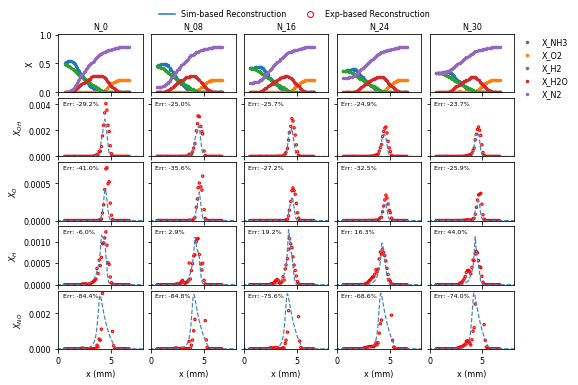

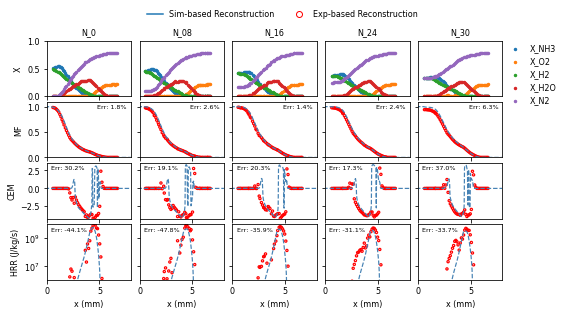

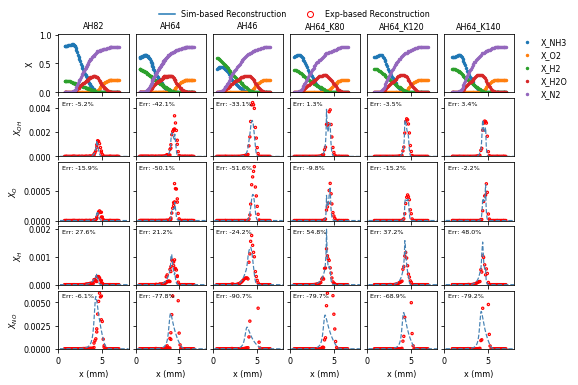

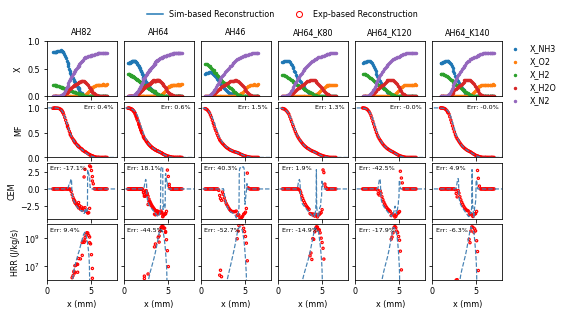

In [ ]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Multi-row / multi-column 1-D counter-flow comparison plotter.

*Distinct* symbols for Exp vs. QSSA now fully parameterized.
"""

import os
from pathlib import Path
from typing import Sequence, Optional, Union, List

import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D


def _as_list(val: Union[float, Sequence[float]], n: int) -> List[float]:
    if isinstance(val, (int, float)):
        return [float(val)] * n
    if len(val) != n:
        raise ValueError("Length of shift lists must match number of cases")
    return list(val)


def plot_counterflow_exp_sim(
    exp_case_dir: str,
    sim_case_dir: str,
    recon_case_dir: Optional[str],
    fig_dir: str,
    target_cases: Sequence[str],
    #
    exp_shift: Union[float, Sequence[float]] = 0.0,
    sim_shift: Union[float, Sequence[float]] = 0.0,
    #
    top_species: Sequence[str] = ("X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"),
    data_species: Sequence[str] = ("X_OH", "X_O", "X_H", "X_NH2", "X_NO", "Qdot"),
    #
    x_ranges: Optional[Sequence[Sequence[float]]] = None,
    t_range: Sequence[float] = (500, 2200),
    pdf_name: str = "1D_compact.pdf",
    #
    exp_color: str = "red",
    recon_color: str = "steelblue",
    sim_color: str = "black",
    #
    linewidth: float = 1.2,
    marker_size: float = 5,
    font_size: int = 8,
    #
    exp_marker: str = "o",
    qssa_marker: str = "s",
    top_adjust: float = 0.85,
) -> None:
    """
    exp_marker:     matplotlib marker for experimental points
    qssa_marker:    matplotlib marker for QSSA points
    top_adjust:     top margin for subplots_adjust
    """

    # Pre-compute global y-limits for each species across all cases
    ymins = {sp: float('inf') for sp in top_species + list(data_species)}
    ymaxs = {sp: -float('inf') for sp in top_species + list(data_species)}
    for case in target_cases:
        exp_csv = Path(exp_case_dir) / case / "predicted_X.csv"
        df_exp = pd.read_csv(exp_csv)
        if recon_case_dir:
            recon_csv = Path(recon_case_dir) / case / "predicted_X.csv"
            df_recon = pd.read_csv(recon_csv) if recon_csv.is_file() else None
        else:
            df_recon = None

        for sp in ymins:
            if sp in df_exp:
                arr = df_exp[sp].to_numpy()
                if sp == "X_NO":
                    arr = arr / 1e6
                ymins[sp] = min(ymins[sp], arr.min())
                ymaxs[sp] = max(ymaxs[sp], arr.max()) * 1.01
            if df_recon is not None and sp in df_recon.columns:
                arr = df_recon[sp].to_numpy()
                ymins[sp] = min(ymins[sp], arr.min())
                ymaxs[sp] = max(ymaxs[sp], arr.max()) * 1.01
                
    n_cols = len(target_cases)
    exp_shift_l = _as_list(exp_shift, n_cols)
    sim_shift_l = _as_list(sim_shift, n_cols)
    n_rows = len(data_species) + 1

    if x_ranges is None:
        x_ranges = [[None, None]] * n_cols

    plt.rcParams.update({"font.size": font_size})
    fig, axs = plt.subplots(
        n_rows, n_cols,
        figsize=(8.73, 1.1 * n_rows),
        sharex=False, sharey=False
    )

    first_row_handles, first_row_labels = [], []

    for col_idx, case in enumerate(target_cases):
        exp_csv = Path(exp_case_dir) / case / "predicted_X.csv"
        sim_csv = Path(sim_case_dir) / f"{case}.csv"
        recon_csv = (Path(recon_case_dir) / case / "predicted_X.csv" if recon_case_dir else None)

        df_exp = pd.read_csv(exp_csv)
        df_sim = pd.read_csv(sim_csv)
        df_recon = pd.read_csv(recon_csv) if recon_csv and Path(recon_csv).is_file() else None

        x_exp = df_exp.get("x", df_exp.columns[1]).to_numpy() + exp_shift_l[col_idx]
        x_rec = df_sim["grid"].to_numpy() * 1000 + sim_shift_l[col_idx]

        # ── TOP ROW ────────────────────────────────────────────────
        ax_top = axs[0, col_idx]
        for sp in top_species:
            sc_exp = ax_top.scatter(
                x_exp, df_exp[sp].to_numpy(),
                s=marker_size, marker=exp_marker, linewidths=linewidth
            )
            if col_idx == 0:
                first_row_handles.append(sc_exp)
                first_row_labels.append(sp)

        ax_top.set_ylim(
            ymins[top_species[0]], ymaxs[top_species[0]]
        ) if len(top_species) == 1 else ax_top.set_ylim(0, 1.01)
        ax_top.set_title(case, fontsize=font_size)
        ax_top.set_xticklabels([])
        if col_idx == 0:
            ax_top.set_ylabel("X", fontsize=font_size)
        else:
            ax_top.set_yticks([])
        xmin, xmax = x_ranges[col_idx]
        if xmin is not None:
            ax_top.set_xlim(xmin, xmax)

        # ── LOWER ROWS ──────────────────────────────────────────────
        for r, sp in enumerate(data_species, start=1):
            ax = axs[r, col_idx]

            # QSSA: line + marker
            if df_recon is not None and sp in df_recon.columns:
                y_rec = df_recon[sp].to_numpy()
                # if sp == "X_NO":
                #     y_rec = y_rec / 1e6
                ax.plot(
                    x_rec, y_rec,
                    linestyle='--', linewidth=linewidth,
                    color= recon_color,
                    label="QSSA" if (r == 1 and col_idx == 0) else ""
                )

            # Experimental: scatter
            if sp in df_exp.columns:
                y_exp = df_exp[sp].to_numpy()
                ax.scatter(
                    x_exp, y_exp,
                    s=marker_size, marker=exp_marker,
                    facecolors='none', edgecolors=exp_color,
                    linewidths=linewidth,
                    label="Exp" if (r == 1 and col_idx == 0) else ""
                )

            # Compute and print relative error at peak
            if df_recon is not None and sp in df_recon.columns and sp in df_exp.columns:
                recon_arr = df_recon[sp].to_numpy()
                exp_arr = df_exp[sp].to_numpy()
                if sp == "X_NO":
                    recon_arr = recon_arr / 1e6
                    exp_arr = exp_arr / 1e6
                recon_peak = recon_arr.max()
                exp_peak = exp_arr.max()
                rel_err = (recon_peak - exp_peak) / exp_peak * 100
                print(f"[{case}][{sp}] Relative peak error: {rel_err:.2f}%")
                
                if sp == "MF":
                    # place in upper-right
                    ax.text(
                        0.95, 0.95,
                        f"Err: {rel_err:.1f}%",
                        transform=ax.transAxes,
                        fontsize=font_size * 0.8,
                        horizontalalignment='right',
                        verticalalignment='top'
                    )
                else:
                    # default: upper-left
                    ax.text(
                        0.05, 0.95,
                        f"Err: {rel_err:.1f}%",
                        transform=ax.transAxes,
                        fontsize=font_size * 0.8,
                        verticalalignment='top'
                    )

            # Apply consistent y-limits
            if sp != "Qdot":
                ax.set_ylim(ymins[sp], ymaxs[sp])

            # Qdot log scale
            if sp == "Qdot":
                ax.set_yscale("log")
                ax.set_ylim(1e6, 1e10)
                y_label = "HRR (J/kg/s)"
            else:
                y_label = sp

            xmin, xmax = x_ranges[col_idx]
            if xmin is not None:
                ax.set_xlim(xmin, xmax)

            if col_idx == 0:
                # format y-labels: species with 'X_' get LaTeX subscripts, Qdot gets HRR label
                if sp == 'Qdot':
                    ax.set_ylabel('HRR (J/kg/s)', fontsize=font_size)
                elif sp.startswith('X_'):
                    sub = sp.split('_', 1)[1]
                    ax.set_ylabel(f"$X_{{{sub}}}$", fontsize=font_size)
                else:
                    ax.set_ylabel(sp, fontsize=font_size)
            else: ax.set_yticklabels([])
            if r == len(data_species):
                ax.set_xlabel("x (mm)", fontsize=font_size)
            else:
                ax.set_xticklabels([])

    # ── LEGENDS & SAVE ─────────────────────────────────────────────
    axs[0, -1].legend(
        first_row_handles, first_row_labels,
        loc="upper left", bbox_to_anchor=(1.02, 1), borderaxespad=0,
        ncol=1, fontsize=font_size, frameon=False
    )

    handles_global = [
        Line2D([0], [0], marker="None", linestyle="-",
               markerfacecolor="none", markeredgecolor=recon_color, label="Sim-based Reconstruction"),
        Line2D([0], [0], marker=exp_marker, linestyle="None",
               markerfacecolor="none", markeredgecolor=exp_color, label="Exp-based Reconstruction"),
    ]
    plt.subplots_adjust(top=top_adjust, right=0.85, wspace=0.1, hspace=0.1)
    fig = plt.gcf()
    fig.legend(
        handles=handles_global, loc="upper center", ncol=2,
        fontsize=font_size, frameon=False, bbox_to_anchor=(0.5, 1)
    )

    Path(fig_dir).mkdir(parents=True, exist_ok=True)
    out_pdf = Path(fig_dir) / pdf_name
    fig.savefig(out_pdf, dpi=300, bbox_inches="tight")
    print(f"figure saved → {out_pdf}")


# ––––– Case set with individual shifts –––––
plot_counterflow_exp_sim(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_NH3",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["X_OH", "X_O", "X_H", "X_NO"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="N_series_1D_compact_NH3.pdf",
    exp_marker="o",
    qssa_marker="s",
    top_adjust=0.92,    # lift the title/legend up
)

# ––––– Second plot (different species set) –––––
plot_counterflow_exp_sim(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_NH3",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0", "N_08", "N_16", "N_24", "N_30"],
    exp_shift=[2.4, 2.5, 2.65, 2.76, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["MF", "CEM", "Qdot"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="N_series_1D_compact_CEM_NH3.pdf",
    exp_marker="o",
    qssa_marker="s",
    top_adjust=0.88,    # lift the title/legend up
    
)
# ––––– Case set with individual shifts –––––
plot_counterflow_exp_sim(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_NH3",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["X_OH", "X_O", "X_H", "X_NO"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_series_1D_compact_NH3.pdf",
    exp_marker="o",
    qssa_marker="s",
    top_adjust=0.92,    # lift the title/legend up
    
)

# ––––– Second plot (different species set) –––––
plot_counterflow_exp_sim(
    exp_case_dir="figs/QSSA/EXP_data/NH3_NP_CF_EXP",
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_NH3",
    fig_dir="figs/NH3_NP_CF",
    target_cases=['AH82', 'AH64', 'AH46',
     'AH64_K80', 'AH64_K120', 'AH64_K140'],
    exp_shift=[2.9, 2.45, 2.35, 2.4, 2.75, 2.85],   # mm
    sim_shift=[-2.0, -2.0, -2.0, -2.0, -2.0, -2.0],      # mm (after mirroring)
    top_species=["X_NH3", "X_O2", "X_H2", "X_H2O", "X_N2"],
    data_species=["MF", "CEM", "Qdot"],
    x_ranges=[[0, 8]] * 6,
    pdf_name="AH_series_1D_compact_CEM_NH3.pdf",
    exp_marker="o",
    qssa_marker="s",
    top_adjust=0.88,    # lift the title/legend up
    
)

# Detail species reconstruction comparison
## matrix plot on peak value reconstruction and  Pearson correlation value 



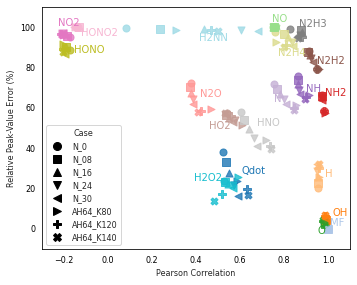

Scatter saved to figs/NH3_NP_CF/pearson_vs_peak_error_labels_ori.pdf


In [ ]:
import os
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
from matplotlib.lines import Line2D
from matplotlib.patches import Ellipse

def plot_corr_vs_peak_error(sim_case_dir,
                            recon_case_dir,
                            fig_dir,
                            target_cases,
                            data_species,        # list of strings
                            pdf_name,
                            cmap_name='tab20',
                            min_peak_threshold=1e-6,
                            label_offsets=None):
    if label_offsets is None:
        label_offsets = {}

    # 1) load N_0 to threshold & order
    df_sim_N0   = pd.read_csv(Path(sim_case_dir) / "N_0.csv")
    sp_peaks_N0 = {sp: df_sim_N0[sp].max() for sp in data_species}
    filtered    = [sp for sp in data_species
                   if sp_peaks_N0.get(sp, 0) >= min_peak_threshold]
    ordered_sp  = sorted(filtered,
                         key=lambda sp: sp_peaks_N0[sp],
                         reverse=True)

    # 2) build color & marker maps
    cases = target_cases
    cmap  = plt.get_cmap(cmap_name)
    species_colors = {sp: cmap(i / len(ordered_sp)) for i, sp in enumerate(ordered_sp)}
    marker_list = ['o','s','^','v','<','>','P','X','D','*','h','+','x','|','_']
    case_markers = {case: marker_list[i % len(marker_list)] for i, case in enumerate(cases)}

    # 3) collect data
    records = []
    for case in cases:
        df_sim   = pd.read_csv(Path(sim_case_dir) / f"{case}.csv")
        recon_p  = Path(recon_case_dir) / case / "predicted_X.csv"
        df_recon = pd.read_csv(recon_p) if recon_p.is_file() else None

        for sp in ordered_sp:
            tp = df_sim[sp].max()
            rp = df_recon[sp].max() if df_recon is not None else np.nan
            err = (abs(rp - tp)/abs(tp)*100) if tp!=0 else np.nan
            err = min(err,100)

            tvals = df_sim[sp].values
            rvals = df_recon[sp].values if df_recon is not None else np.full_like(tvals, np.nan)
            m = min(len(tvals), len(rvals))
            tvals, rvals = tvals[:m], rvals[:m]
            corr = pearsonr(tvals, rvals)[0] if m>1 and not np.isnan(tvals).any() and not np.isnan(rvals).any() else np.nan

            records.append((case, sp, corr, err))

    df = pd.DataFrame(records, columns=['case','species','corr','error'])

    # 4) plot
    fig, ax = plt.subplots(figsize=(5,4))
    species_centroids = {}

    for case, group in df.groupby('case'):
        for sp, sub in group.groupby('species'):
            ax.scatter(sub['corr'], sub['error'],
                       color=species_colors[sp],
                       marker=case_markers[case],
                       s=50, alpha=0.8)
            # accumulate centroids
            c = (sub['corr'].mean(), sub['error'].mean())
            species_centroids.setdefault(sp, []).append(c)

    # draw ellipses + inline labels
    for sp, pts in species_centroids.items():
        xs, ys = zip(*pts)
        xc, yc = np.mean(xs), np.mean(ys)
        w = (max(xs)-min(xs))*1  or 0.05
        h = (max(ys)-min(ys))*1.2 or 5.0

        color = species_colors[sp]
        # ell = Ellipse((xc, yc), w, h,
        #               edgecolor=color, facecolor='none', lw=1, alpha=0.6)
        # ax.add_patch(ell)

        dx, dy = label_offsets.get(sp, (-w/2, 0))
        # Remove the "X_" from the species name for better labeling
        sp_name = sp.replace("X_", "")  # Remove the "X_" prefix
        ax.text(xc+dx, yc+dy, sp_name,
                fontsize=10, color=color,
                ha='left', va='center', alpha=1)

    ax.set_xlabel('Pearson Correlation')
    ax.set_ylabel('Relative Peak‐Value Error (%)')
    ax.set_xlim(-0.3, 1.1)
    ax.set_ylim(-10, 110)

    # Case‐marker legend only
    case_handles = [
        Line2D([0],[0],
               marker=case_markers[c],
               color='k', linestyle='',
               markersize=8, label=c)
        for c in cases
    ]
    ax.legend(handles=case_handles,
              title='Case',
              bbox_to_anchor=(0,0),
              loc='lower left')

    plt.tight_layout()
    os.makedirs(fig_dir, exist_ok=True)
    outpath = Path(fig_dir) / pdf_name
    plt.savefig(outpath, format='pdf')
    plt.show()
    plt.close()
    print(f'Scatter saved to {outpath}')

plot_corr_vs_peak_error(
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_ori",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0","N_08","N_16","N_24","N_30","AH64_K80","AH64_K120","AH64_K140"],
    data_species=[
        "X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_NH","X_N","X_NNH","X_NH2OH",
        "X_H2NO","X_HNOH","X_HNO","X_HON","X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN","MF","Qdot", "CEM"
    ],
    pdf_name="pearson_vs_peak_error_labels_ori.pdf",
    cmap_name='tab20',
    min_peak_threshold=1e-6,
    label_offsets={
    'X_H':   (0.03,  0),
    'X_O':   (-0.03, -4),
    'X_OH':  (0.03,  3),
    'X_NO2':  (-0.03,  6),
    
    'X_N2O':  (0.02,  3),
    'X_HONO2':  (0.02,  -3),
    'X_N2H3':  (0,  5),
    'X_NH2':  (0.01,  5),
    
    'X_N2H2':  (0.02,  0),
    'X_NH':  (0.02,  0),
    'X_N2H4':  (-0.03,  -6),
    'X_H2NN':  (0,  -4),
    'X_HONO':  (0.04,  0),
    'X_NO':  (-0.01,  4),
    'Qdot':  (0.03,  4),
    'X_HO2':  (-0.1,  -4),
    'X_H2O2':  (-0.15,  4),
    'X_HNO':  (0,  6),
    'MF':  (0.01,  3),
}
)

## add OH, will it be different

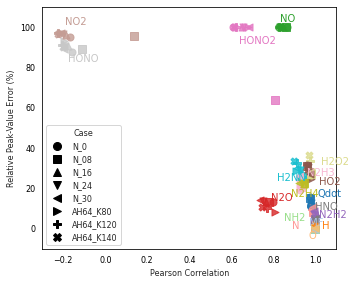

Scatter saved to figs/NH3_NP_CF/pearson_vs_peak_error_labels_OH.pdf


In [ ]:
plot_corr_vs_peak_error(
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_OH",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0","N_08","N_16","N_24","N_30","AH64_K80","AH64_K120","AH64_K140"],
    data_species=[
        "X_NO","X_H","X_O","X_HO2","X_H2O2","X_NH2","X_N","X_NNH","X_NH2OH",
        "X_H2NO","X_HNOH","X_HNO","X_HON","X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN","MF","Qdot", "CEM"
    ],
    pdf_name="pearson_vs_peak_error_labels_OH.pdf",
    cmap_name='tab20',
    min_peak_threshold=1e-6,
    label_offsets={
    'X_H':   (0.03,  0),
    'X_O':   (-0.03, -4),
    'X_N':   (-0.1, -8),
    'X_OH':  (0.03,  3),
    'X_NO2':  (-0.03,  6),
    'X_N2O':  (0.02,  3),
    'X_HONO2':  (-0.03,  -2),
    'X_N2H3':  (0.03,  5),
    'X_NH2':  (-0.15,  5),
    'X_N2H2':  (0.02,  0),
    'X_NH':  (0.02,  0),
    'X_N2H4':  (-0.06,  -6),
    'X_H2NN':  (-0.1,  -4),
    'X_HONO':  (0,  -6),
    'X_NO':  (-0.01,  4),
    'Qdot':  (0.03,  4),
    'X_HO2':  (0.05,  -6),
    'X_H2O2':  (0.05,  4),
    'X_HNO':  (0,  6),
    'MF':  (-0.03,  3),
}
)

## Add NH

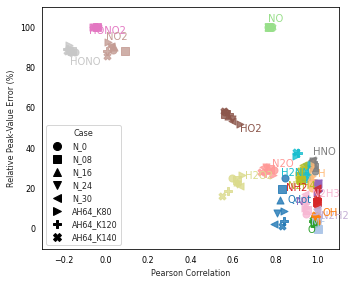

Scatter saved to figs/NH3_NP_CF/pearson_vs_peak_error_labels_NH.pdf


In [ ]:
plot_corr_vs_peak_error(
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_NH",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0","N_08","N_16","N_24","N_30","AH64_K80","AH64_K120","AH64_K140"],
    data_species=[
        "X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_N","X_NNH","X_NH2OH",
        "X_H2NO","X_HNOH","X_HNO","X_HON","X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN","MF","Qdot", "CEM"
    ],
    pdf_name="pearson_vs_peak_error_labels_NH.pdf",
    cmap_name='tab20',
    min_peak_threshold=1e-6,
    label_offsets={
    'X_H':   (0.03,  0),
    'X_O':   (-0.03, -4),
    'X_N':   (-0.1, -8),
    'X_OH':  (0.03,  3),
    'X_NO2':  (-0.03,  6),
    'X_N2O':  (0.02,  3),
    'X_HONO2':  (-0.03,  -2),
    'X_N2H3':  (0.03,  5),
    'X_NH2':  (-0.15,  5),
    'X_N2H2':  (0.02,  0),
    'X_NH':  (0.02,  0),
    'X_N2H4':  (-0.06,  -6),
    'X_H2NN':  (-0.1,  -4),
    'X_HONO':  (0,  -6),
    'X_NO':  (-0.01,  4),
    'Qdot':  (0.03,  4),
    'X_HO2':  (0.05,  -6),
    'X_H2O2':  (0.05,  4),
    'X_HNO':  (0,  6),
    'MF':  (-0.03,  3),
}
)

## Add NH2

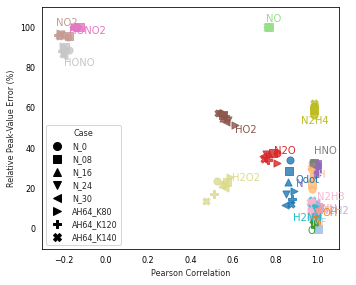

Scatter saved to figs/NH3_NP_CF/pearson_vs_peak_error_labels_NH2.pdf


In [ ]:
plot_corr_vs_peak_error(
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_NH2",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0","N_08","N_16","N_24","N_30","AH64_K80","AH64_K120","AH64_K140"],
    data_species=[
        "X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH","X_N","X_NNH","X_NH2OH",
        "X_H2NO","X_HNOH","X_HNO","X_HON","X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN","MF","Qdot", "CEM"
    ],
    pdf_name="pearson_vs_peak_error_labels_NH2.pdf",
    cmap_name='tab20',
    min_peak_threshold=1e-6,
    label_offsets={
    'X_H':   (0.03,  0),
    'X_O':   (-0.03, -4),
    'X_N':   (-0.1, -8),
    'X_OH':  (0.03,  3),
    'X_NO2':  (-0.03,  6),
    'X_N2O':  (0.02,  3),
    'X_HONO2':  (-0.03,  -2),
    'X_N2H3':  (0.03,  5),
    'X_NH2':  (-0.15,  5),
    'X_N2H2':  (0.02,  0),
    'X_NH':  (0.02,  0),
    'X_N2H4':  (-0.06,  -6),
    'X_H2NN':  (-0.1,  -4),
    'X_HONO':  (0,  -6),
    'X_NO':  (-0.01,  4),
    'Qdot':  (0.03,  4),
    'X_HO2':  (0.05,  -6),
    'X_H2O2':  (0.05,  4),
    'X_HNO':  (0,  6),
    'MF':  (-0.03,  3),
}
)

# Add HNO

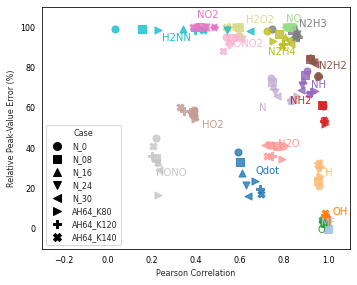

Scatter saved to figs/NH3_NP_CF/pearson_vs_peak_error_labels_HNO.pdf


In [ ]:
plot_corr_vs_peak_error(
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_HNO",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0","N_08","N_16","N_24","N_30","AH64_K80","AH64_K120","AH64_K140"],
    data_species=[
        "X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_NH","X_N","X_NNH","X_NH2OH",
        "X_H2NO","X_HNOH","X_HON","X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN","MF","Qdot", "CEM"
    ],
    pdf_name="pearson_vs_peak_error_labels_HNO.pdf",
    cmap_name='tab20',
    min_peak_threshold=1e-6,
    label_offsets={
    'X_H':   (0.03,  0),
    'X_O':   (-0.03, -4),
    'X_N':   (-0.1, -8),
    'X_OH':  (0.03,  3),
    'X_NO2':  (-0.03,  6),
    'X_N2O':  (0.02,  3),
    'X_HONO2':  (-0.03,  -2),
    'X_N2H3':  (0.03,  5),
    'X_NH2':  (-0.15,  5),
    'X_N2H2':  (0.02,  0),
    'X_NH':  (0.02,  0),
    'X_N2H4':  (-0.06,  -6),
    'X_H2NN':  (-0.1,  -4),
    'X_HONO':  (0,  -6),
    'X_NO':  (-0.01,  4),
    'Qdot':  (0.03,  4),
    'X_HO2':  (0.05,  -6),
    'X_H2O2':  (0.05,  4),
    'X_HNO':  (0,  6),
    'MF':  (-0.03,  3),
}
)

## Add NO

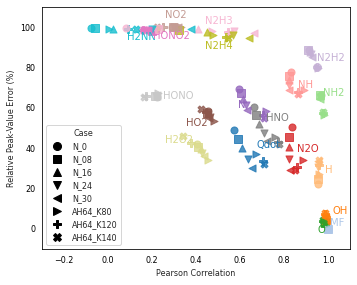

Scatter saved to figs/NH3_NP_CF/pearson_vs_peak_error_labels_NO.pdf


In [ ]:
plot_corr_vs_peak_error(
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_NO",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0","N_08","N_16","N_24","N_30","AH64_K80","AH64_K120","AH64_K140"],
    data_species=[
        "X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_NH","X_N","X_NNH","X_NH2OH",
        "X_H2NO","X_HNOH","X_HNO","X_HON","X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN","MF","Qdot", "CEM"
    ],
    pdf_name="pearson_vs_peak_error_labels_NO.pdf",
    cmap_name='tab20',
    min_peak_threshold=1e-6,
    label_offsets={
    'X_H':   (0.03,  0),
    'X_O':   (-0.03, -4),
    'X_OH':  (0.03,  3),
    'X_NO2':  (-0.03,  6),
    
    'X_N2O':  (0.02,  3),
    'X_HONO2':  (0.02,  -3),
    'X_N2H3':  (0,  5),
    'X_NH2':  (0.01,  5),
    
    'X_N2H2':  (0.02,  0),
    'X_NH':  (0.02,  0),
    'X_N2H4':  (-0.03,  -6),
    'X_H2NN':  (0,  -4),
    'X_HONO':  (0.04,  0),
    'X_NO':  (-0.01,  4),
    'Qdot':  (0.03,  4),
    'X_HO2':  (-0.1,  -4),
    'X_H2O2':  (-0.15,  4),
    'X_HNO':  (0,  6),
    'MF':  (0.01,  3),
}
)

## Add H

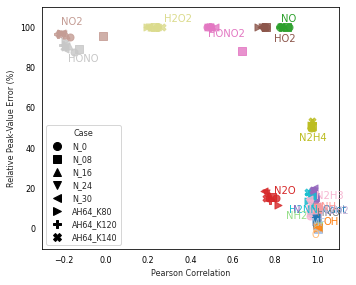

Scatter saved to figs/NH3_NP_CF/pearson_vs_peak_error_labels_H.pdf


In [ ]:
plot_corr_vs_peak_error(
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_H",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0","N_08","N_16","N_24","N_30","AH64_K80","AH64_K120","AH64_K140"],
    data_species=[
        "X_NO","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_NH","X_N","X_NNH","X_NH2OH",
        "X_H2NO","X_HNOH","X_HNO","X_HON","X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN","MF","Qdot", "CEM"
    ],
    pdf_name="pearson_vs_peak_error_labels_H.pdf",
    cmap_name='tab20',
    min_peak_threshold=1e-6,
    label_offsets={
    'X_H':   (0.03,  0),
    'X_O':   (-0.03, -4),
    'X_N':   (-0.1, -8),
    'X_OH':  (0.03,  3),
    'X_NO2':  (-0.03,  6),
    'X_N2O':  (0.02,  3),
    'X_HONO2':  (-0.03,  -2),
    'X_N2H3':  (0.03,  5),
    'X_NH2':  (-0.15,  5),
    'X_N2H2':  (0.02,  0),
    'X_NH':  (0.02,  0),
    'X_N2H4':  (-0.06,  -6),
    'X_H2NN':  (-0.1,  -4),
    'X_HONO':  (0,  -6),
    'X_NO':  (-0.01,  4),
    'Qdot':  (0.03,  4),
    'X_HO2':  (0.05,  -6),
    'X_H2O2':  (0.05,  4),
    'X_HNO':  (0,  6),
    'MF':  (-0.03,  3),
}
)

## Add O

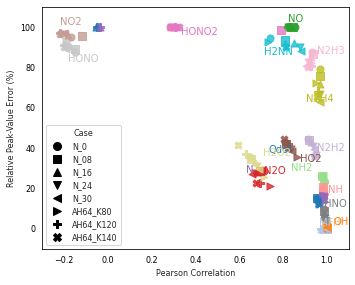

Scatter saved to figs/NH3_NP_CF/pearson_vs_peak_error_labels_O.pdf


In [ ]:
plot_corr_vs_peak_error(
    sim_case_dir="SIM_results/NH3_NP_CF_reduce",
    recon_case_dir="figs/QSSA/SIM_results/NH3_NP_CF_reduce_O",
    fig_dir="figs/NH3_NP_CF",
    target_cases=["N_0","N_08","N_16","N_24","N_30","AH64_K80","AH64_K120","AH64_K140"],
    data_species=[
        "X_NO","X_H","X_OH","X_HO2","X_H2O2","X_NH2","X_NH","X_N","X_NNH","X_NH2OH",
        "X_H2NO","X_HNOH","X_HNO","X_HON","X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN","MF","Qdot", "CEM"
    ],
    pdf_name="pearson_vs_peak_error_labels_O.pdf",
    cmap_name='tab20',
    min_peak_threshold=1e-6,
    label_offsets={
    'X_H':   (0.03,  0),
    'X_O':   (-0.03, -4),
    'X_N':   (-0.1, -8),
    'X_OH':  (0.03,  3),
    'X_NO2':  (-0.03,  6),
    'X_N2O':  (0.02,  3),
    'X_HONO2':  (-0.03,  -2),
    'X_N2H3':  (0.03,  5),
    'X_NH2':  (-0.15,  5),
    'X_N2H2':  (0.02,  0),
    'X_NH':  (0.02,  0),
    'X_N2H4':  (-0.06,  -6),
    'X_H2NN':  (-0.1,  -4),
    'X_HONO':  (0,  -6),
    'X_NO':  (-0.01,  4),
    'Qdot':  (0.03,  4),
    'X_HO2':  (0.05,  -6),
    'X_H2O2':  (0.05,  4),
    'X_HNO':  (0,  6),
    'MF':  (-0.03,  3),
}
)

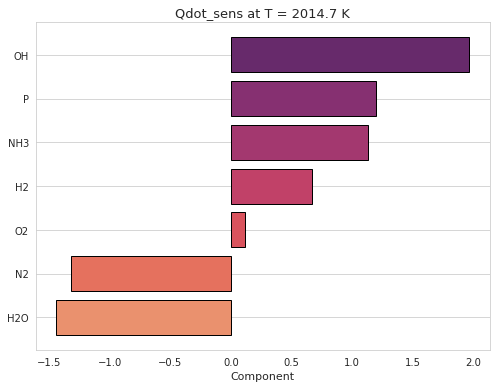

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def plot_sensitivity_tornado(csv_path, sens_target, main_species, output_fig_dir):
    """
    Tornado plot of a given sensitivity metric at the max T, with no vertical grid lines,
    using Matplotlib barh and a Seaborn palette.
    """
    # 1) Load data
    df = pd.read_csv(csv_path)
    
    # 2) Max‐T slice
    max_T = df["T"].max()
    df_maxT = df[df["T"] == max_T]
    
    # 3) Filter to perturbed parameters
    df_filt = df_maxT[df_maxT["parameter"].isin(main_species)]
    
    # 4) Sort for plotting
    plot_df = (
        df_filt
        .set_index("parameter")[[sens_target]]
        .sort_values(sens_target)
    )
    
    # 5) Get a Seaborn palette
    sns.set_style("whitegrid")
    colors = sns.color_palette("flare", len(plot_df))
    
    # 6) Create the figure
    fig, ax = plt.subplots(figsize=(7, 0.5*len(plot_df) + 2))
    
    # 7) Draw horizontal bars
    bars = ax.barh(
        y=plot_df.index,
        width=plot_df[sens_target],
        color=colors,
        edgecolor="k"
    )
    
    # 8) Remove vertical gridlines
    ax.xaxis.grid(False)
    
    # 9) Annotate each bar
    for bar in bars:
        w = bar.get_width()
        y = bar.get_y() + bar.get_height()/2

    # 10) Labels & title
    ax.set_xlabel(f"Component", fontsize=11)
    ax.set_title(f"{sens_target} at T = {max_T:.1f} K", fontsize=13)
    
    # 11) Save & show
    plt.tight_layout()
    os.makedirs(output_fig_dir, exist_ok=True)
    out_file = os.path.join(output_fig_dir, f"tornado_{sens_target}_T{max_T:.0f}.png")
    plt.savefig(out_file, dpi=300)
    plt.show()
    

# plot_sensitivity_tornado(
#     csv_path="figs/NH3_NP_CF/sensitivity_analysis/OH_sensitivity_gradients_relative_0.0001.csv",
#     sens_target="Qdot_sens",
#     main_species=["P", "H2", "O2", "H2O", "N2", "NH3", "OH"],
#     output_fig_dir="figs/NH3_NP_CF/sensitivity_analysis"
# )

# plot_sensitivity_tornado(
#     csv_path="figs/NH3_NP_CF/sensitivity_analysis/NH3_sensitivity_gradients_relative_0.0001.csv",
#     sens_target="Qdot_sens",
#     main_species=["P", "H2", "O2", "H2O", "N2", "NH3"],
#     output_fig_dir="figs/NH3_NP_CF/sensitivity_analysis"
# )

# Let's UQ the Correlation Plot

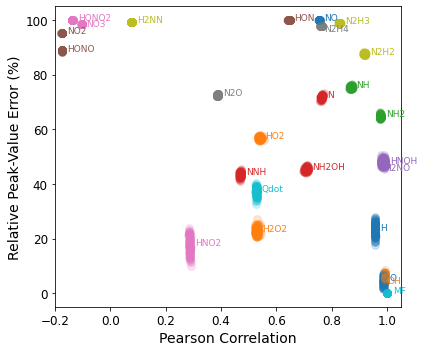

Saved scatter plot to figs/NH3_NP_CF/corr_vs_error_N_30.png


In [ ]:
import re
import os
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

def plot_corr_vs_peak_error_uq_iter(
    baseline_dir,
    uq_case_dir,
    fig_dir,
    data_species,
    pdf_name,
    cmap_name='tab20',
    min_peak_threshold=1e-6,
    label_offsets=None,
    max_iters=100
):
    """
    baseline_dir: path to folder containing your N_0.csv, N_1.csv, etc.
    uq_case_dir:  path to the single-case folder that has outputs/uncertainty_outputs_iter*.csv
    max_iters:    maximum number of iteration files to read (None for all)
    """
    if label_offsets is None:
        label_offsets = {}

    baseline_dir = Path(baseline_dir)
    uq_case_dir  = Path(uq_case_dir)

    # Extract case name (e.g. "N_0")
    case_name = uq_case_dir.name

    # 1) Load baseline simulation
    baseline_csv = baseline_dir / f"{case_name}.csv"
    if not baseline_csv.is_file():
        raise FileNotFoundError(f"Could not find baseline file: {baseline_csv}")
    df_base = pd.read_csv(baseline_csv)

    # Only use the requested species in the given order
    ordered_sp = list(data_species)
    # Compute baseline peaks for error calculation
    sp_peaks = {sp: df_base[sp].max() for sp in ordered_sp}

    # 2) Find all UQ iteration files
    out_dir = uq_case_dir / "outputs"
    iter_files = sorted(
        out_dir.glob("uncertainty_outputs_iter*.csv"),
        key=lambda p: int(re.search(r"iter(\d+)", p.name).group(1))
    )
    # limit to first N iters
    if max_iters is not None:
        iter_files = iter_files[:max_iters]

    # 3) Prepare colors
    cmap = plt.get_cmap(cmap_name)
    species_colors = {
        sp: cmap(i / len(ordered_sp))
        for i, sp in enumerate(ordered_sp)
    }

    # 4) Collect corr & error data
    records = []
    for p in iter_files:
        it = int(re.search(r"iter(\d+)", p.name).group(1))
        df_iter = pd.read_csv(p)
        for sp in ordered_sp:
            tp = sp_peaks[sp]
            rp = df_iter[sp].max()
            err = abs(rp - tp) / abs(tp) * 100 if tp != 0 else np.nan
            err = min(err, 100.0)

            tvals = df_base[sp].values
            rvals = df_iter[sp].values
            m = min(len(tvals), len(rvals))
            corr = (
                pearsonr(tvals[:m], rvals[:m])[0]
                if m > 1 and not np.isnan(tvals).any() and not np.isnan(rvals).any()
                else np.nan
            )

            records.append((it, sp, corr, err))

    df = pd.DataFrame(records, columns=['iteration','species','corr','error'])

    # 5) Plot
    fig, ax = plt.subplots(figsize=(6,5))
    centroids = {}

    for _, row in df.iterrows():
        sp    = row['species']
        corr  = row['corr']
        error = row['error']
        ax.scatter(corr, error,
                   color=species_colors[sp],
                   marker='o',      # always circle
                   s=60,
                   alpha=0.2)       # semi-transparent
        # accumulate for label positioning
        centroids.setdefault(sp, []).append((corr, error))

    # Inline labels at each species' centroid
    for sp, pts in centroids.items():
        xs, ys = zip(*pts)
        xc, yc = np.mean(xs), np.mean(ys)
        w = 0.01
        h = (max(ys) - min(ys)) or 5.0
        dx, dy = label_offsets.get(sp, (w*2, 0))
        
        ax.text(xc+dx, yc+dy, sp.replace("X_",""),
                color=species_colors[sp],
                fontsize=9)

    ax.set_xlabel('Pearson Correlation')
    ax.set_ylabel('Relative Peak‐Value Error (%)')
    ax.set_xlim(-0.2, 1.05)
    ax.set_ylim(-5, 105)

    plt.tight_layout()
    os.makedirs(fig_dir, exist_ok=True)
    outpath = Path(fig_dir) / pdf_name
    plt.savefig(outpath)
    plt.show()
    print(f"Saved scatter plot to {outpath}")


# Example call:
plot_corr_vs_peak_error_uq_iter(
    baseline_dir="SIM_results/NH3_NP_CF_reduce",
    uq_case_dir="figs/NH3_NP_CF/UQ_analysis/N_0",
    fig_dir="figs/NH3_NP_CF",
    pdf_name="corr_vs_error_N_30.png",
    cmap_name='tab10',
    data_species=[
        "X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_NH",
        "X_N","X_NNH","X_NH2OH","X_H2NO","X_HNOH","X_HON",
        "X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN",
        "MF","Qdot"
    ],
    label_offsets={
        'X_NO3':   (0.015,  -1),
        'X_N2H4':  (0.01,   -2),
        'X_H2NO':  (0.01,   -3),
        'X_OH':    (0.01,   -2),
    },
    max_iters=100  # only read the first 100 iter files
)

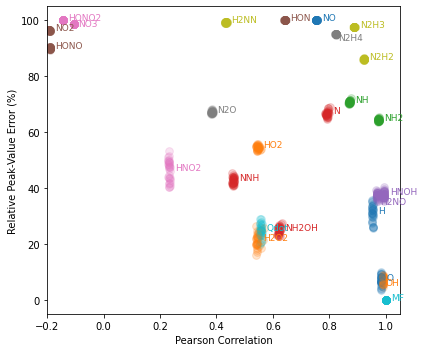

Saved scatter plot to figs/NH3_NP_CF/corr_vs_error_N_16.png


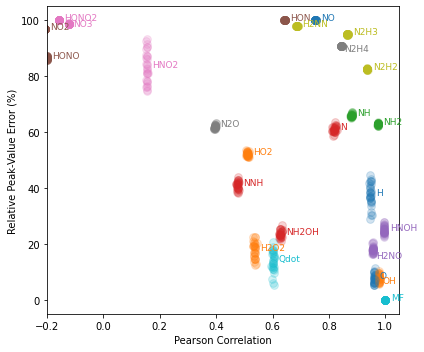

Saved scatter plot to figs/NH3_NP_CF/corr_vs_error_N_30.png


In [ ]:
# Example call:
plot_corr_vs_peak_error_uq_iter(
    baseline_dir="SIM_results/NH3_NP_CF_reduce",
    uq_case_dir="figs/NH3_NP_CF/UQ_analysis/N_16",
    fig_dir="figs/NH3_NP_CF",
    pdf_name="corr_vs_error_N_16.png",
    cmap_name='tab10',
    data_species=[
        "X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_NH",
        "X_N","X_NNH","X_NH2OH","X_H2NO","X_HNOH","X_HON",
        "X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN",
        "MF","Qdot"
    ],
    label_offsets={
    'X_NO3':   (0.015,  -1),
    'X_N2H4':   (0.01,  -2),
    'X_H2NO':   (0.01,  -3),
    'X_OH':   (0.01,  -2),
    },
    max_iters=100  # only read the first 100 iter files
)

# Example call:
plot_corr_vs_peak_error_uq_iter(
    baseline_dir="SIM_results/NH3_NP_CF_reduce",
    uq_case_dir="figs/NH3_NP_CF/UQ_analysis/N_30",
    fig_dir="figs/NH3_NP_CF",
    pdf_name="corr_vs_error_N_30.png",
    cmap_name='tab10',
    data_species=[
        "X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_NH",
        "X_N","X_NNH","X_NH2OH","X_H2NO","X_HNOH","X_HON",
        "X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN",
        "MF","Qdot"
    ],
    label_offsets={
    'X_NO3':   (0.015,  -1),
    'X_N2H4':   (0.01,  -2),
    'X_H2NO':   (0.01,  -3),
    'X_OH':   (0.01,  -2),
    },
    max_iters=100  # only read the first 100 iter files
)



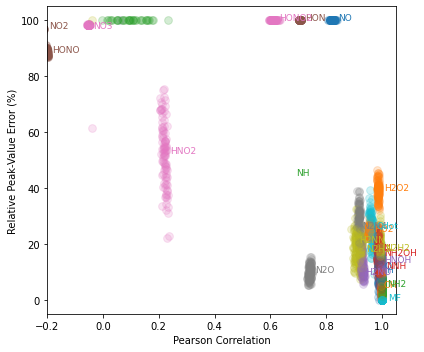

Saved scatter plot to figs/NH3_NP_CF/OH_corr_vs_error_N_16.png


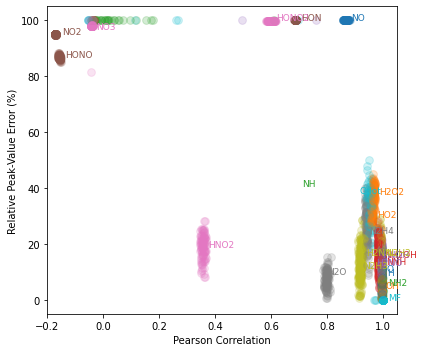

Saved scatter plot to figs/NH3_NP_CF/OH_corr_vs_error_N_30.png


In [ ]:
# Example call:
plot_corr_vs_peak_error_uq_iter(
    baseline_dir="SIM_results/NH3_NP_CF_reduce",
    uq_case_dir="figs/NH3_NP_CF/UQ_OH_analysis/N_30",
    fig_dir="figs/NH3_NP_CF",
    pdf_name="OH_corr_vs_error_N_16.png",
    cmap_name='tab10',
    data_species=[
        "X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_NH",
        "X_N","X_NNH","X_NH2OH","X_H2NO","X_HNOH","X_HON",
        "X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN",
        "MF","Qdot"
    ],
    label_offsets={
    'X_NO3':   (0.015,  -1),
    'X_N2H4':   (0.01,  -2),
    'X_H2NO':   (0.01,  -3),
    'X_OH':   (0.01,  -2),
    },
    max_iters=100  # only read the first 100 iter files

)

# Example call:
plot_corr_vs_peak_error_uq_iter(
    baseline_dir="SIM_results/NH3_NP_CF_reduce",
    uq_case_dir="figs/NH3_NP_CF/UQ_OH_analysis/N_0",
    fig_dir="figs/NH3_NP_CF",
    pdf_name="OH_corr_vs_error_N_30.png",
    cmap_name='tab10',
    data_species=[
        "X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_NH",
        "X_N","X_NNH","X_NH2OH","X_H2NO","X_HNOH","X_HON",
        "X_NO2","X_HONO","X_HNO2","X_NO3","X_HONO2",
        "X_N2O","X_N2H4","X_N2H3","X_N2H2","X_H2NN",
        "MF","Qdot"
    ],
    label_offsets={
    'X_NO3':   (0.015,  -1),
    'X_N2H4':   (0.01,  -2),
    'X_H2NO':   (0.01,  -3),
    'X_OH':   (0.01,  -2),
    },
    max_iters=100  # only read the first 100 iter files

)



Suggested species order: ['X_O', 'X_OH', 'HRR', 'X_H2O2', 'X_H', 'X_NNH', 'X_HO2', 'X_N', 'X_N2O', 'X_NH2', 'X_NH', 'X_N2H2', 'X_HNO2', 'X_NO2', 'X_NO3', 'X_NO']


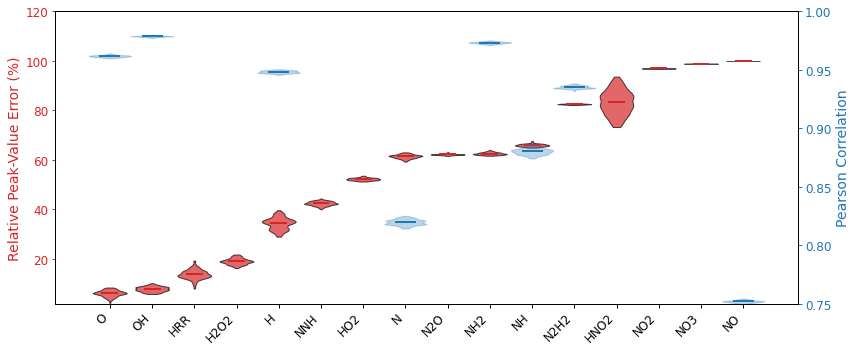

Saved violin plot to figs/NH3_NP_CF/error_corr_violin_by_species_N_30.pdf


In [ ]:
import re
import os
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

def plot_error_and_corr_violin_by_species(
    baseline_dir,
    uq_case_dir,
    fig_dir,
    data_species,
    pdf_name,
    max_iters=100,
    species_order=None
):
    """
    Paper-quality twin-violin plot:
      - Left Y-axis (red): distribution of Relative Peak-Value Error (%) with mean line
      - Right Y-axis (blue): distribution of Pearson Correlation with mean line
      - X-axis: species names in the given or suggested order
    """
    # 1) Publication style
    plt.rcParams.update({
        'font.family':     'sans-serif',
        'axes.titlesize':  16,
        'axes.labelsize':  14,
        'xtick.labelsize': 12,
        'ytick.labelsize': 12,
        'axes.linewidth':  1.0,
        'xtick.major.width':1.0,
        'ytick.major.width':1.0,
        'grid.linestyle':  '--',
        'grid.color':      '0.8',
        'grid.linewidth':  0.5,
        'axes.grid':       False,
        'pdf.fonttype':    42,
        'ps.fonttype':     42,
    })

    # 2) Load & compute
    baseline_dir = Path(baseline_dir)
    uq_case_dir  = Path(uq_case_dir)
    case_name    = uq_case_dir.name

    df_base = pd.read_csv(baseline_dir / f"{case_name}.csv")
    species = list(data_species)
    peaks   = {sp: df_base[sp].max() for sp in species}

    out_dir = uq_case_dir / "outputs"
    files = sorted(
        out_dir.glob("uncertainty_outputs_iter*.csv"),
        key=lambda p: int(re.search(r"iter(\d+)", p.name).group(1))
    )[:max_iters]

    records = []
    for p in files:
        df_iter = pd.read_csv(p, usecols=species)
        for sp in species:
            tp = peaks[sp]
            rp = df_iter[sp].max()
            err = abs(rp - tp)/abs(tp)*100 if tp != 0 else np.nan
            err = min(err, 100.0)

            tvals = df_base[sp].values
            rvals = df_iter[sp].values
            m = min(len(tvals), len(rvals))
            corr = (
                pearsonr(tvals[:m], rvals[:m])[0]
                if m>1 and not np.isnan(tvals).any() and not np.isnan(rvals).any()
                else np.nan
            )
            records.append((sp, err, corr))

    df = pd.DataFrame(records, columns=['species','error','corr'])

    # 3) Determine order
    if species_order is None:
        species_order = (
            df.groupby('species')['error']
              .mean()
              .sort_values()
              .index
              .tolist()
        )
        print("Suggested species order:", species_order)

    # 4) Prepare violin data
    error_data = [df.loc[df.species==sp, 'error'].values for sp in species_order]
    corr_data  = [df.loc[df.species==sp, 'corr'].values  for sp in species_order]

    # 5) Plot
    fig, ax_err = plt.subplots(figsize=(12,5))
    ax_corr = ax_err.twinx()
    positions = np.arange(len(species_order))

    # a) Error violins with mean line
    parts_e = ax_err.violinplot(
        error_data,
        positions=positions,
        showmeans=True,
        showextrema=False,
        showmedians=False,
        widths=0.8,
        bw_method=0.3
    )
    for pc in parts_e['bodies']:
        pc.set_facecolor('#D62728')
        pc.set_edgecolor('black')
        pc.set_alpha(0.7)
    parts_e['cmeans'].set_color('#D62728')  # red mean bar
    parts_e['cmeans'].set_linewidth(2)

    # b) Correlation violins with mean line
    parts_c = ax_corr.violinplot(
        corr_data,
        positions=positions,
        showmeans=True,
        showextrema=False,
        showmedians=False,
        widths=1.0,
        bw_method=0.3
    )
    for pc in parts_c['bodies']:
        pc.set_facecolor('#1F77B4')
        pc.set_edgecolor('#1F77B4')
        pc.set_alpha(0.3)
        pc.set_linewidth(1)
    parts_c['cmeans'].set_color('#1F77B4')  # blue mean bar
    parts_c['cmeans'].set_linewidth(2)

    # 6) Labels & styling
    ax_err.set_xticks(positions)
    ax_err.set_xticklabels([sp.replace("X_","") for sp in species_order],
                           rotation=45, ha='right')
    ax_err.set_ylabel('Relative Peak-Value Error (%)', color='#D62728')
    # ax_err.set_yscale('log')
    ax_corr.set_ylabel('Pearson Correlation', color='#1F77B4')

    ax_err.tick_params(axis='y', colors='#D62728')
    ax_corr.tick_params(axis='y', colors='#1F77B4')

    # y-limits
    err_min = np.nanmin(df.error[df.error>0])
    ax_err.set_ylim(err_min*0.8, df.error.max()*1.2)
    ax_corr.set_ylim(0.5, 1.0)

    # reference line
    ax_corr.axhline(1.0, color='gray', lw=0.8, linestyle='--')

    # hide top/right spines
    # for spine in ['top','right']:
    #     ax_err.spines[spine].set_visible(False)
    #     ax_corr.spines[spine].set_visible(False)

    plt.tight_layout()

    # 7) Save
    os.makedirs(fig_dir, exist_ok=True)
    outpath = Path(fig_dir)/pdf_name
    fig.savefig(outpath, format='pdf', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"Saved violin plot to {outpath}")

    return species_order


# Example call:
species_order = plot_error_and_corr_violin_by_species(
    baseline_dir="SIM_results/NH3_NP_CF_reduce",
    uq_case_dir="figs/NH3_NP_CF/UQ_analysis/N_30",
    fig_dir="figs/NH3_NP_CF",
    pdf_name="error_corr_violin_by_species_N_30.pdf",
    data_species=[
        "HRR","X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2",
        "X_NH2","X_NH","X_N","X_NNH","X_NO2","X_HNO2",
        "X_NO3","X_N2O","X_N2H2"
    ],
    max_iters=100
)

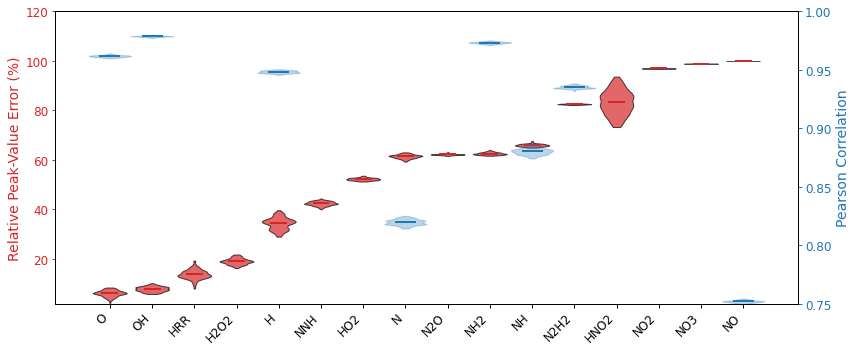

Saved violin plot to figs/NH3_NP_CF/error_corr_by_species_N_30_ordered.pdf


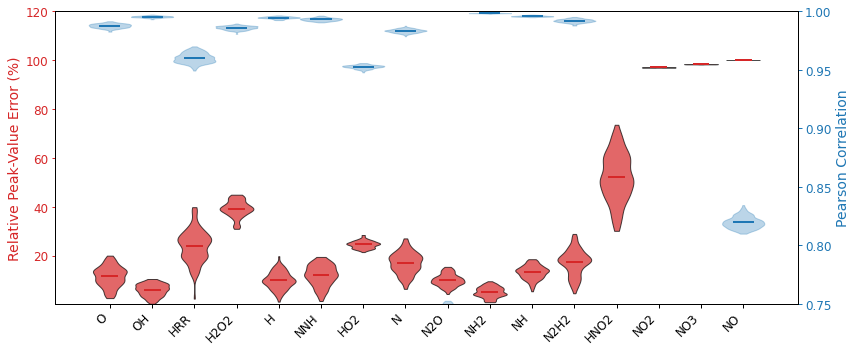

Saved violin plot to figs/NH3_NP_CF/error_corr_by_species_N_30_OH_pub.png


['X_O',
 'X_OH',
 'HRR',
 'X_H2O2',
 'X_H',
 'X_NNH',
 'X_HO2',
 'X_N',
 'X_N2O',
 'X_NH2',
 'X_NH',
 'X_N2H2',
 'X_HNO2',
 'X_NO2',
 'X_NO3',
 'X_NO']

In [ ]:
plot_error_and_corr_violin_by_species(
    baseline_dir="SIM_results/NH3_NP_CF_reduce",
    uq_case_dir="figs/NH3_NP_CF/UQ_analysis/N_30",
    fig_dir="figs/NH3_NP_CF",
    pdf_name="error_corr_by_species_N_30_ordered.pdf",
    data_species=[
        "HRR","X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_NH",
        "X_N","X_NNH","X_NO2","X_HNO2","X_NO3","X_N2O","X_N2H2"
    ],
    max_iters=100,
    species_order=species_order
)

# ── Example call ────────────────────────────────────────────────────────────
plot_error_and_corr_violin_by_species(
    baseline_dir="SIM_results/NH3_NP_CF_reduce",
    uq_case_dir="figs/NH3_NP_CF/UQ_OH_analysis/N_30",
    fig_dir="figs/NH3_NP_CF",
    pdf_name="error_corr_by_species_N_30_OH_pub.png",
    data_species=[
        "HRR", "X_NO","X_H","X_O","X_OH","X_HO2","X_H2O2","X_NH2","X_NH",
        "X_N","X_NNH", "X_NO2","X_HNO2","X_NO3", 
        "X_N2O","X_N2H2"
    ],
    max_iters=100,
    species_order=species_order
)

Final species order (top to bottom): ['X_NO', 'X_NO3', 'X_NO2', 'X_HNO2', 'X_N2H2', 'X_NH', 'X_NH2', 'X_N2O', 'X_N', 'X_HO2', 'X_NNH', 'X_H', 'X_H2O2', 'HRR', 'X_OH', 'X_O']


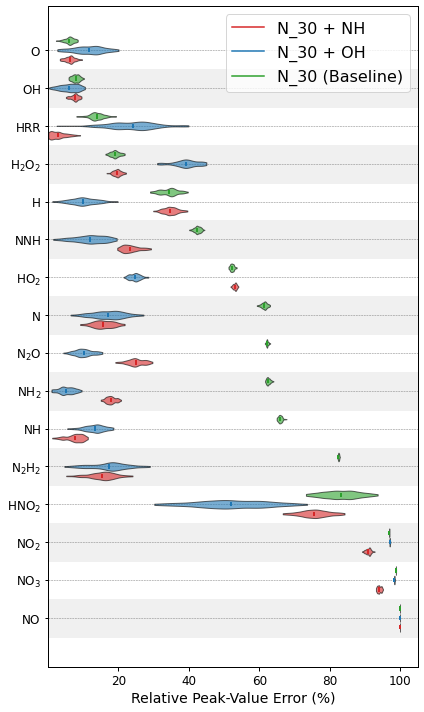

Saved horizontal violin plot to figs/NH3_NP_CF/compare_multi_error_violin_horizontal.pdf


In [ ]:
import re
import os
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_comparison_error_violin_by_species_multi(
    baseline_dir,
    uq_case_dirs,
    legend_names,
    fig_dir,
    data_species,
    pdf_name,
    max_iters=100,
    species_order=None
):
    """
    Horizontal violin plot: Relative Peak-Value Error (%) across species and UQ cases,
    with reversed species y-axis and top-down case plotting order matching the legend.
    """
    plt.rcParams.update({
        'font.family':     'sans-serif',
        'axes.titlesize':  16,
        'axes.labelsize':  14,
        'xtick.labelsize': 12,
        'ytick.labelsize': 12,
        'axes.linewidth':  1.0,
        'xtick.major.width':1.0,
        'ytick.major.width':1.0,
        'axes.grid':       False,
        'pdf.fonttype':    42,
        'ps.fonttype':     42,
    })

    species_label_map = {
        "HRR": "HRR",
        "X_NO": r"$\mathrm{NO}$",
        "X_H": r"$\mathrm{H}$",
        "X_O": r"$\mathrm{O}$",
        "X_OH": r"$\mathrm{OH}$",
        "X_HO2": r"$\mathrm{HO_2}$",
        "X_H2O2": r"$\mathrm{H_2O_2}$",
        "X_NH2": r"$\mathrm{NH_2}$",
        "X_NH": r"$\mathrm{NH}$",
        "X_N": r"$\mathrm{N}$",
        "X_NNH": r"$\mathrm{NNH}$",
        "X_NO2": r"$\mathrm{NO_2}$",
        "X_HNO2": r"$\mathrm{HNO_2}$",
        "X_NO3": r"$\mathrm{NO_3}$",
        "X_N2O": r"$\mathrm{N_2O}$",
        "X_N2H2": r"$\mathrm{N_2H_2}$",
    }

    assert len(uq_case_dirs) == len(legend_names), "Mismatch between cases and legend names"

    def compute_errors(uq_case_dir):
        uq_case_dir = Path(uq_case_dir)
        case_name = uq_case_dir.name
        df_base = pd.read_csv(Path(baseline_dir) / f"{case_name}.csv")
        peaks = {sp: df_base[sp].max() for sp in data_species}
        out_dir = uq_case_dir / "outputs"
        files = sorted(out_dir.glob("uncertainty_outputs_iter*.csv"),
                       key=lambda p: int(re.search(r"iter(\d+)", p.name).group(1)))[:max_iters]

        records = []
        for p in files:
            df_iter = pd.read_csv(p, usecols=data_species)
            for sp in data_species:
                tp = peaks[sp]
                rp = df_iter[sp].max()
                err = abs(rp - tp)/abs(tp)*100 if tp != 0 else np.nan
                err = min(err, 100.0)
                records.append((sp, err))
        return pd.DataFrame(records, columns=['species', 'error'])

    all_dfs = [compute_errors(case_dir) for case_dir in uq_case_dirs]

    # Determine and reverse species order
    if species_order is None:
        species_order = (
            all_dfs[0].groupby('species')['error']
                     .mean()
                     .sort_values()
                     .index
                     .tolist()
        )

    species_order = list(reversed(species_order))  # reverse to show last one on top
    print("Final species order (top to bottom):", species_order)

    fig, ax = plt.subplots(figsize=(6, 10))
    base_positions = np.arange(len(species_order))  # natural order, will appear top-down due to reversed species_order

    num_cases = len(uq_case_dirs)
    spacing = 0.25
    total_width = spacing * (num_cases - 1)
    color_palette = ['#D62728', '#1F77B4', '#2CA02C', '#9467BD', '#FF7F0E']

    species_with_data = set()

    for idx, pos in enumerate(base_positions):
        if idx % 2 == 0:
            ax.axhspan(pos - 0.5, pos + 0.5, color="#f0f0f0", zorder=0)

    for i, (df, name) in enumerate(zip(all_dfs[::-1], legend_names[::-1])):
        offset = -total_width / 2 + i * spacing
        error_data = []
        valid_positions = []

        for j, sp in enumerate(species_order):
            vals = df[df.species == sp]['error'].dropna().values
            if len(vals) > 0:
                error_data.append(vals)
                valid_positions.append(base_positions[j] + offset)
                species_with_data.add(sp)

        if error_data:
            parts = ax.violinplot(
                error_data,
                positions=valid_positions,
                showmeans=True,
                showextrema=False,
                showmedians=False,
                widths=spacing * 0.9,
                bw_method=0.3,
                vert=False
            )
            for pc in parts['bodies']:
                pc.set_facecolor(color_palette[i % len(color_palette)])
                pc.set_edgecolor('black')
                pc.set_alpha(0.6)
            parts['cmeans'].set_color(color_palette[i % len(color_palette)])
            parts['cmeans'].set_linewidth(2)
            ax.plot([], [], color=color_palette[i % len(color_palette)], label=name)

    for pos in base_positions:
        ax.axhline(pos, color='gray', linestyle='--', linewidth=0.5, zorder=0)

    final_species = [sp for sp in species_order if sp in species_with_data]
    final_positions = [base_positions[i] for i, sp in enumerate(species_order) if sp in species_with_data]
    tick_labels = [species_label_map.get(sp, sp.replace("X_", "")) for sp in final_species]

    ax.set_yticks(final_positions)
    ax.set_yticklabels(tick_labels)
    ax.set_xlabel('Relative Peak-Value Error (%)', color='black')

    all_errors = pd.concat(all_dfs)['error']
    all_errors = all_errors.dropna()
    all_errors = all_errors[all_errors > 0]
    if not all_errors.empty:
        err_min = np.nanmin(all_errors)
        err_max = np.nanmax(all_errors)
        ax.set_xlim(err_min * 0.8, 105)

    ax.legend(loc='upper right', fontsize=16)
    plt.tight_layout()

    os.makedirs(fig_dir, exist_ok=True)
    outpath = Path(fig_dir) / pdf_name
    fig.savefig(outpath, format='pdf', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"Saved horizontal violin plot to {outpath}")
    
plot_comparison_error_violin_by_species_multi(
    baseline_dir="SIM_results/NH3_NP_CF_reduce",
    uq_case_dirs=[
        "figs/NH3_NP_CF/UQ_analysis/N_30",
        "figs/NH3_NP_CF/UQ_OH_analysis_noise_10/N_30",
        "figs/NH3_NP_CF/UQ_NH_analysis_noise_10/N_30"
    ],
    legend_names = [
        "N_30 (Baseline)",
        "N_30 + OH",
        "N_30 + NH"
    ],
    fig_dir="figs/NH3_NP_CF",
    pdf_name="compare_multi_error_violin_horizontal.pdf",
    data_species=[
        "HRR", "X_NO", "X_H", "X_O", "X_OH", "X_HO2", "X_H2O2",
        "X_NH2", "X_NH", "X_N", "X_NNH", "X_NO2", "X_HNO2",
        "X_NO3", "X_N2O", "X_N2H2"
    ],
    max_iters=100
)

# Create a similar figure with Pearson Correlations

Species order: ['X_N2O', 'X_NNH', 'X_HO2', 'X_H2O2', 'HRR', 'X_NO', 'X_N', 'X_NH', 'X_N2H2', 'X_H', 'X_O', 'X_NH2', 'X_OH']


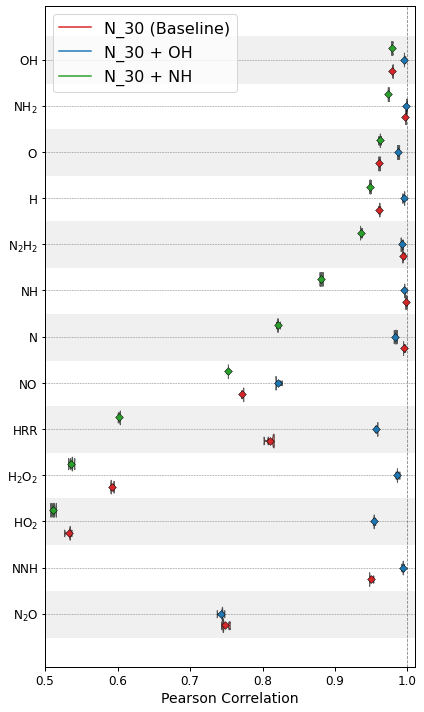

Saved correlation violin plot to figs/NH3_NP_CF/compare_multi_corr_violin_horizontal_zoomed.pdf


In [ ]:
import re
import os
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

def plot_comparison_corr_violin_by_species_multi(
    baseline_dir,
    uq_case_dirs,
    legend_names,
    fig_dir,
    data_species,
    pdf_name,
    max_iters=100,
    species_order=None
):
    """
    Horizontal violin plot: Pearson Correlation across species and UQ cases,
    with LaTeX-style species labels and case plotting order reversed to match legend top-down.
    """
    plt.rcParams.update({
        'font.family':     'sans-serif',
        'axes.titlesize':  16,
        'axes.labelsize':  14,
        'xtick.labelsize': 12,
        'ytick.labelsize': 12,
        'axes.linewidth':  1.0,
        'xtick.major.width':1.0,
        'ytick.major.width':1.0,
        'axes.grid':       False,
        'pdf.fonttype':    42,
        'ps.fonttype':     42,
    })

    assert len(uq_case_dirs) == len(legend_names), "Mismatch between cases and legend names"

    # Custom labels with LaTeX-style subscripts
    species_label_map = {
        "HRR": "HRR",
        "X_NO": r"$\mathrm{NO}$",
        "X_H": r"$\mathrm{H}$",
        "X_O": r"$\mathrm{O}$",
        "X_OH": r"$\mathrm{OH}$",
        "X_HO2": r"$\mathrm{HO_2}$",
        "X_H2O2": r"$\mathrm{H_2O_2}$",
        "X_NH2": r"$\mathrm{NH_2}$",
        "X_NH": r"$\mathrm{NH}$",
        "X_N": r"$\mathrm{N}$",
        "X_NNH": r"$\mathrm{NNH}$",
        "X_NO2": r"$\mathrm{NO_2}$",
        "X_HNO2": r"$\mathrm{HNO_2}$",
        "X_NO3": r"$\mathrm{NO_3}$",
        "X_N2O": r"$\mathrm{N_2O}$",
        "X_N2H2": r"$\mathrm{N_2H_2}$"
    }

    def compute_correlations(uq_case_dir):
        uq_case_dir = Path(uq_case_dir)
        case_name = uq_case_dir.name
        df_base = pd.read_csv(Path(baseline_dir) / f"{case_name}.csv")
        out_dir = uq_case_dir / "outputs"
        files = sorted(out_dir.glob("uncertainty_outputs_iter*.csv"),
                       key=lambda p: int(re.search(r"iter(\d+)", p.name).group(1)))[:max_iters]

        records = []
        for p in files:
            df_iter = pd.read_csv(p, usecols=data_species)
            for sp in data_species:
                tvals = df_base[sp].values
                rvals = df_iter[sp].values
                m = min(len(tvals), len(rvals))
                if m > 1 and not np.isnan(tvals[:m]).any() and not np.isnan(rvals[:m]).any():
                    corr = pearsonr(tvals[:m], rvals[:m])[0]
                else:
                    corr = np.nan
                records.append((sp, corr))
        return pd.DataFrame(records, columns=['species', 'corr'])

    all_dfs = [compute_correlations(case_dir) for case_dir in uq_case_dirs]

    if species_order is None:
        species_order = (
            all_dfs[0].groupby('species')['corr']
                     .mean()
                     .sort_values()
                     .index
                     .tolist()
        )

    # No reversal of species order
    print("Species order:", species_order)

    fig, ax = plt.subplots(figsize=(6, 10))
    positions = np.arange(len(species_order))
    num_cases = len(uq_case_dirs)
    spacing = 0.25
    total_width = spacing * (num_cases - 1)
    color_palette = ['#D62728', '#1F77B4', '#2CA02C', '#9467BD', '#FF7F0E']

    species_with_data = set()

    # Optional: background stripes
    for idx, pos in enumerate(positions):
        if idx % 2 == 0:
            ax.axhspan(pos - 0.5, pos + 0.5, color="#f0f0f0", zorder=0)

    # Reverse case plotting only (to match legend order top-down)
    for i, (df, label) in enumerate(zip(reversed(all_dfs), (legend_names))):
        offset = -total_width / 2 + i * spacing
        corr_data = []
        valid_positions = []
        means = []

        for j, sp in enumerate(species_order):
            vals = df[df.species == sp]['corr'].dropna().values
            if len(vals) > 0:
                corr_data.append(vals)
                valid_positions.append(positions[j] + offset)
                means.append(np.nanmean(vals))
                species_with_data.add(sp)

        if corr_data:
            parts = ax.violinplot(
                corr_data,
                positions=valid_positions,
                showmeans=False,
                showextrema=False,
                showmedians=False,
                widths=spacing * 1.2,
                bw_method=0.1,
                vert=False
            )
            for pc in parts['bodies']:
                pc.set_facecolor(color_palette[i % len(color_palette)])
                pc.set_edgecolor('black')
                pc.set_alpha(0.6)
            ax.scatter(means, valid_positions,
                       color=color_palette[i % len(color_palette)],
                       s=30, marker='D', zorder=3,
                       edgecolor='black', linewidth=0.5)
            ax.plot([], [], color=color_palette[i % len(color_palette)], label=label)

    for pos in positions:
        ax.axhline(pos, color='gray', linestyle='--', linewidth=0.5, zorder=0)
    ax.axvline(1.0, color='gray', linestyle='--', linewidth=0.8, zorder=0)

    final_species = [sp for sp in species_order if sp in species_with_data]
    final_positions = [positions[i] for i, sp in enumerate(species_order) if sp in species_with_data]
    label_list = [species_label_map.get(sp, sp.replace("X_", "")) for sp in final_species]

    ax.set_yticks(final_positions)
    ax.set_yticklabels(label_list)
    ax.set_xlabel('Pearson Correlation', color='black')

    ax.set_xlim(0.5, 1.01)
    ax.legend(loc='upper left', fontsize=16)
    plt.tight_layout()

    os.makedirs(fig_dir, exist_ok=True)
    outpath = Path(fig_dir) / pdf_name
    fig.savefig(outpath, format='pdf', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"Saved correlation violin plot to {outpath}")


plot_comparison_corr_violin_by_species_multi(
    baseline_dir="SIM_results/NH3_NP_CF_reduce",
    uq_case_dirs=[
        "figs/NH3_NP_CF/UQ_analysis/N_30",
        "figs/NH3_NP_CF/UQ_OH_analysis_noise_10/N_30",
        "figs/NH3_NP_CF/UQ_NH_analysis_noise_10/N_30"
    ],
    legend_names = [
        "N_30 (Baseline)",
        "N_30 + OH",
        "N_30 + NH"
    ],
    fig_dir="figs/NH3_NP_CF",
    pdf_name="compare_multi_corr_violin_horizontal_zoomed.pdf",
    # data_species=[
    #     "HRR", "X_NO", "X_H", "X_O", "X_OH", "X_HO2", "X_H2O2",
    #     "X_NH2", "X_NH", "X_N", "X_NNH", "X_NO2", "X_HNO2",
    #     "X_NO3", "X_N2O", "X_N2H2"
    # ],
    data_species=[
        "HRR", "X_NO", "X_H", "X_O", "X_OH", "X_HO2", "X_H2O2",
        "X_NH2", "X_NH", "X_N", "X_NNH", 
        "X_N2O", "X_N2H2"
    ],

    max_iters=5
)
